**1 - Obtenha o dataset ANIMAL-POSE DATASET**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Descompactar o arquivo zipado
import zipfile
import os

zip_path = "/content/drive/MyDrive/POSE-ESTIMATION/archive (2).zip"
extract_dir = "/content/drive/MyDrive/POSE-ESTIMATION"  # Diretório para extrair os arquivos

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

# Verificar os arquivos extraídos
os.listdir(extract_dir)

KeyboardInterrupt: 

In [3]:
import json
import os

# Caminho do arquivo JSON
annotation_file = os.path.join(extract_dir, 'keypoints.json')

# Carregar o JSON
with open(annotation_file, 'r') as f:
    data = json.load(f)

# Visualizar as chaves principais do JSON
print(data.keys())

# Explorar uma amostra de imagens e anotações
print(f"Exemplo de uma imagem: {list(data['images'].items())[0]}")
print(f"Exemplo de uma anotação: {data['annotations'][0]}")

dict_keys(['images', 'annotations', 'categories', 'info'])
Exemplo de uma imagem: ('1', '2007_000063.jpg')
Exemplo de uma anotação: {'image_id': 1, 'bbox': [123, 115, 379, 275], 'keypoints': [[193, 216, 1], [160, 217, 1], [174, 261, 1], [204, 186, 1], [152, 182, 1], [0, 0, 0], [0, 0, 0], [273, 168, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [266, 225, 1], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [190, 145, 1], [351, 238, 1]], 'num_keypoints': 20, 'category_id': 1}


([<matplotlib.axis.XTick at 0x786ebd755720>,
 [Text(0, 0, 'dog'),
  Text(1, 0, 'cat'),
  Text(2, 0, 'sheep'),
  Text(3, 0, 'horse'),
  Text(4, 0, 'cow')])

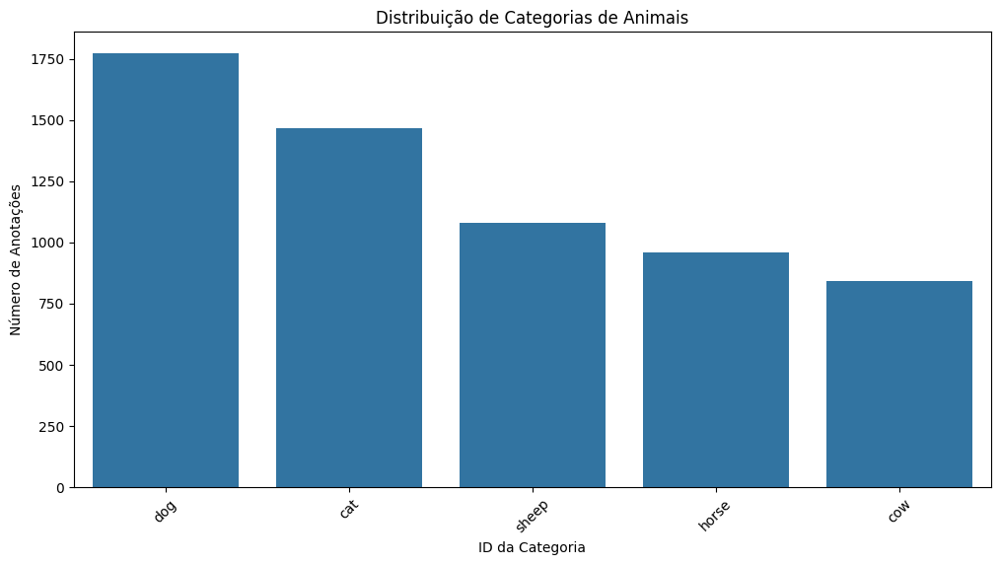

In [6]:
import seaborn as sns
from collections import Counter
import matplotlib.pyplot as plt

categories = {cat['id']: cat['name'] for cat in data['categories']}
category_counts = Counter(ann['category_id'] for ann in data['annotations'])

plt.figure(figsize=(12, 6))
sns.barplot(x=list(category_counts.keys()), y=list(category_counts.values()))
plt.title('Distribuição de Categorias de Animais')
plt.xlabel('ID da Categoria')
plt.ylabel('Número de Anotações')
plt.xticks(range(len(categories)), [categories[i] for i in range(1, len(categories)+1)], rotation=45)

Text(0.5, 1.0, 'Distribuição de Categorias de Animais')

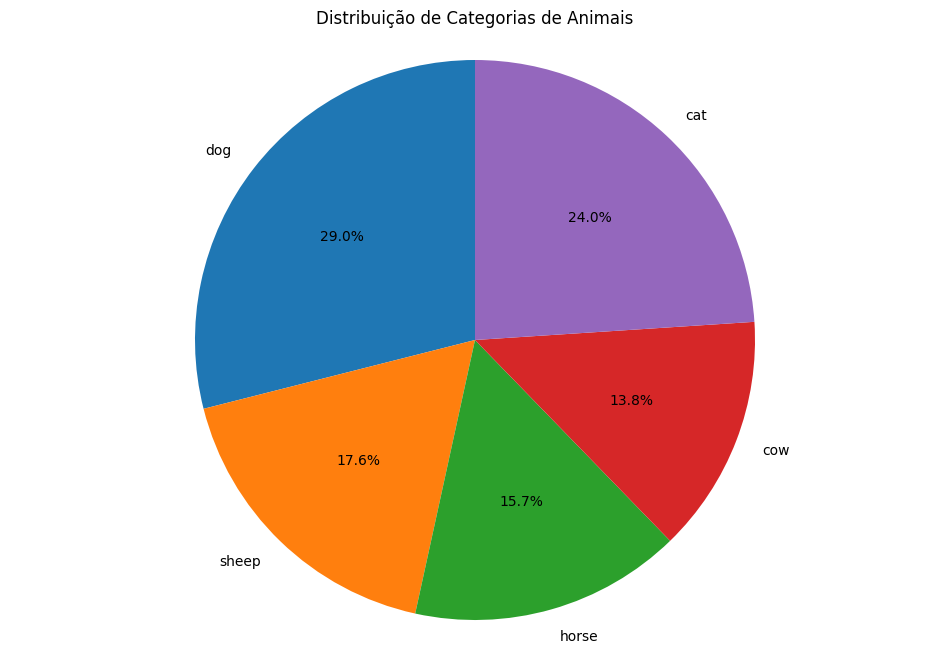

In [7]:
categories = {cat['id']: cat['name'] for cat in data['categories']}
category_counts = Counter(ann['category_id'] for ann in data['annotations'])

# Preparar dados para o gráfico de pizza
labels = [categories[i] for i in category_counts.keys()]
sizes = list(category_counts.values())

# Criar o gráfico de pizza
plt.figure(figsize=(12, 8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.title('Distribuição de Categorias de Animais')

In [14]:
print("\n4. Análise das Bounding Boxes:")
widths = []
heights = []
for ann in data['annotations']:
    x, y, w, h = ann['bbox']
    widths.append(w)
    heights.append(h)

print(f"Largura média das bounding boxes: {sum(widths) / len(widths):.2f}")
print(f"Altura média das bounding boxes: {sum(heights) / len(heights):.2f}")


4. Análise das Bounding Boxes:
Largura média das bounding boxes: 336.79
Altura média das bounding boxes: 302.48


In [1]:
# Contar total de imagens e anotações
total_images = len(data['images'])
total_annotations = len(data['annotations'])

# Filtrar anotações de bovinos (category_id == 5)
bovino_annotations = [ann for ann in data['annotations'] if ann['category_id'] == 5]

# Exibir quantidades
print(f"Total de imagens: {total_images}")
print(f"Total de anotações: {total_annotations}")
print(f"Total de anotações de bovinos: {len(bovino_annotations)}")

NameError: name 'data' is not defined

**2 - Faça a filtragem do dataset**

In [5]:
import json
import pandas as pd
import os

# Caminho do arquivo JSON
annotation_file = os.path.join(extract_dir, 'keypoints.json')

# Diretório onde as imagens estão armazenadas (ajuste conforme necessário)
image_dir = os.path.join(extract_dir, 'images')

# Abrir o arquivo JSON e carregar as anotações
with open(annotation_file, 'r') as f:
    data = json.load(f)

# Extraímos as imagens e as anotações
images = data.get('images', {})
annotations = data.get('annotations', [])

# Criar um dicionário que mapeia image_id para o nome do arquivo da imagem
# Modificado para incluir '/images' antes do nome do arquivo
image_id_to_path = {int(img_id): os.path.join('/content/drive/MyDrive/POSE-ESTIMATION/images/images', img_file) for img_id, img_file in images.items()}

# Filtrar apenas as anotações com category_id == 5 (bovinos)
filtered_annotations = [ann for ann in annotations if ann['category_id'] == 5]

# Adicionar o caminho da imagem a cada anotação filtrada
for ann in filtered_annotations:
    ann['image_path'] = image_id_to_path.get(ann['image_id'], None)

# Converter as anotações filtradas em um DataFrame
df_filtered = pd.DataFrame(filtered_annotations)

In [6]:
df_filtered.head()

,image_id,bbox,keypoints,num_keypoints,category_id,image_path
0,5,"[71, 252, 216, 314]","[[103, 269, 1], [86, 269, 1], [92, 284, 1], [1...",20,5,/content/drive/MyDrive/POSE-ESTIMATION/images/...
1,5,"[58, 202, 241, 295]","[[73, 225, 1], [0, 0, 0], [64, 240, 1], [84, 2...",20,5,/content/drive/MyDrive/POSE-ESTIMATION/images/...
2,6,"[2, 2, 459, 334]","[[0, 0, 0], [255, 46, 1], [308, 88, 1], [171, ...",20,5,/content/drive/MyDrive/POSE-ESTIMATION/images/...
3,7,"[341, 102, 500, 406]","[[363, 125, 1], [0, 0, 0], [343, 147, 1], [385...",20,5,/content/drive/MyDrive/POSE-ESTIMATION/images/...
4,16,"[237, 167, 338, 263]","[[248, 205, 1], [0, 0, 0], [238, 222, 1], [254...",20,5,/content/drive/MyDrive/POSE-ESTIMATION/images/...


([<matplotlib.axis.XTick at 0x7914cc4daf50>,
 [Text(1, 0, '1'),
  Text(2, 0, '2'),
  Text(3, 0, '3'),
  Text(4, 0, '4'),
  Text(5, 0, '5'),
  Text(6, 0, '6'),
  Text(7, 0, '7'),
  Text(8, 0, '8'),
  Text(9, 0, '9'),
  Text(10, 0, '10'),
  Text(11, 0, '11'),
  Text(12, 0, '12'),
  Text(13, 0, '13'),
  Text(14, 0, '14'),
  Text(15, 0, '15'),
  Text(16, 0, '16'),
  Text(17, 0, '17'),
  Text(18, 0, '18'),
  Text(19, 0, '19'),
  Text(20, 0, '20')])

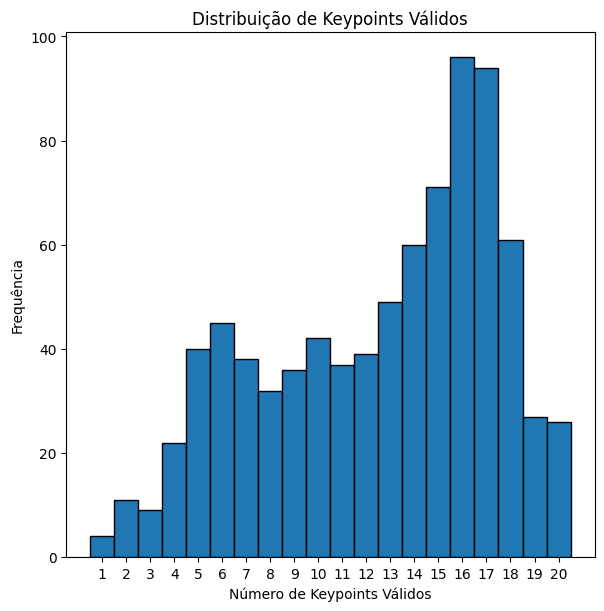

In [13]:
plt.figure(figsize=(15, 15))

# 1. Histograma para num_keypoints (ajustado)
def count_valid_keypoints(keypoints):
    return sum(1 for kp in keypoints if kp != [0, 0, 0])

valid_keypoints_counts = df_filtered['keypoints'].apply(count_valid_keypoints)

plt.subplot(2, 2, 1)
plt.hist(valid_keypoints_counts, bins=range(1, 22), edgecolor='black', align='left')
plt.title('Distribuição de Keypoints Válidos')
plt.xlabel('Número de Keypoints Válidos')
plt.ylabel('Frequência')
plt.xticks(range(1, 21))

<ipython-input-9-e802f5d7b1f9>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(x=keypoints_array[:, 0], y=keypoints_array[:, 1], cmap="YlOrRd", shade=True, cbar=True)


Text(0, 0.5, 'Coordenada Y')

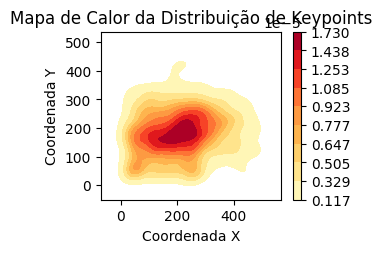

In [9]:
all_keypoints = []
for keypoints in df_filtered['keypoints']:
    all_keypoints.extend([[x, y] for x, y, v in keypoints if v != 0])

keypoints_array = np.array(all_keypoints)

plt.subplot(2, 2, 3)
sns.kdeplot(x=keypoints_array[:, 0], y=keypoints_array[:, 1], cmap="YlOrRd", shade=True, cbar=True)
plt.title('Mapa de Calor da Distribuição de Keypoints')
plt.xlabel('Coordenada X')
plt.ylabel('Coordenada Y')

**3 - Apresente os resultados finais do processamento**

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.9/35.9 MB 29.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 20.0 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4.25.5 which is incompatible.
No pose detected in Image 1
No pose detected in Image 2
No pose detected in Image 3
No pose detected in Image 4


/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


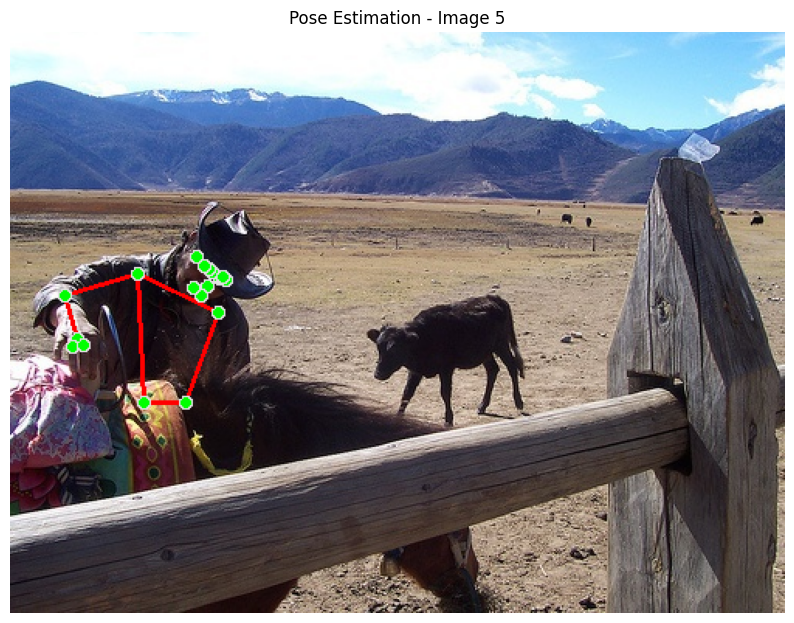

Landmarks for Image 5:
Landmark 0: x=0.25, y=0.44, z=-0.42, visibility=1.00
Landmark 1: x=0.27, y=0.42, z=-0.41, visibility=1.00
Landmark 2: x=0.27, y=0.43, z=-0.41, visibility=1.00
Landmark 3: x=0.28, y=0.43, z=-0.41, visibility=1.00
Landmark 4: x=0.26, y=0.41, z=-0.43, visibility=1.00
Landmark 5: x=0.26, y=0.41, z=-0.43, visibility=1.00
Landmark 6: x=0.25, y=0.40, z=-0.43, visibility=1.00
Landmark 7: x=0.27, y=0.42, z=-0.29, visibility=1.00
Landmark 8: x=0.24, y=0.39, z=-0.37, visibility=1.00
Landmark 9: x=0.25, y=0.45, z=-0.37, visibility=1.00
Landmark 10: x=0.24, y=0.44, z=-0.39, visibility=1.00
Landmark 11: x=0.27, y=0.48, z=-0.18, visibility=1.00
Landmark 12: x=0.17, y=0.42, z=-0.28, visibility=1.00
Landmark 13: x=0.26, y=0.60, z=-0.17, visibility=0.19
Landmark 14: x=0.07, y=0.45, z=-0.39, visibility=0.82
Landmark 15: x=0.26, y=0.60, z=-0.27, visibility=0.13
Landmark 16: x=0.09, y=0.53, z=-0.57, visibility=0.64
Landmark 17: x=0.25, y=0.60, z=-0.30, visibility=0.12
Landmark 18: x=

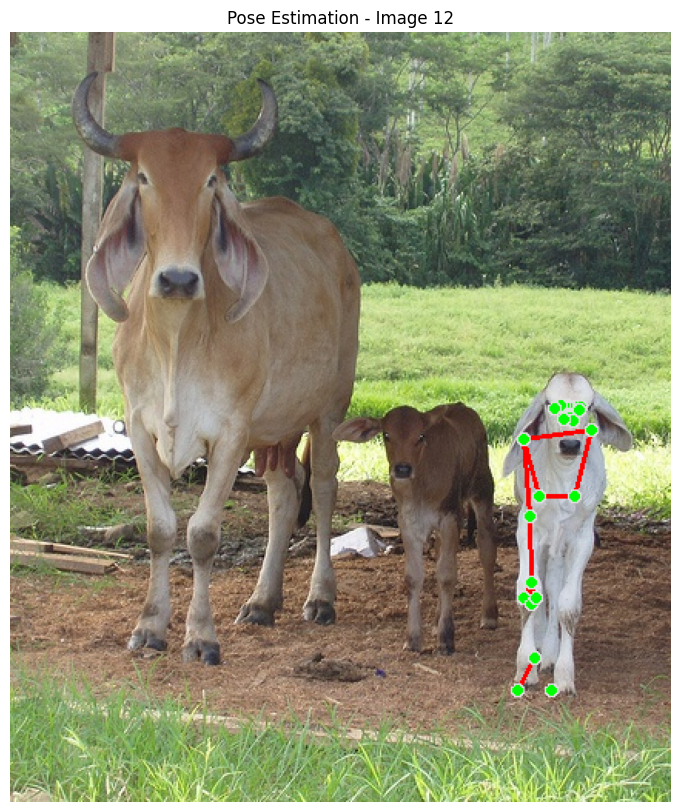

Landmarks for Image 12:
Landmark 0: x=0.85, y=0.50, z=-0.59, visibility=1.00
Landmark 1: x=0.86, y=0.49, z=-0.58, visibility=1.00
Landmark 2: x=0.86, y=0.49, z=-0.59, visibility=0.99
Landmark 3: x=0.86, y=0.49, z=-0.59, visibility=1.00
Landmark 4: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 5: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 6: x=0.83, y=0.49, z=-0.59, visibility=1.00
Landmark 7: x=0.86, y=0.49, z=-0.49, visibility=0.99
Landmark 8: x=0.82, y=0.49, z=-0.52, visibility=1.00
Landmark 9: x=0.85, y=0.51, z=-0.54, visibility=1.00
Landmark 10: x=0.84, y=0.50, z=-0.55, visibility=1.00
Landmark 11: x=0.88, y=0.52, z=-0.37, visibility=1.00
Landmark 12: x=0.78, y=0.53, z=-0.40, visibility=1.00
Landmark 13: x=0.91, y=0.53, z=-0.23, visibility=0.36
Landmark 14: x=0.79, y=0.63, z=-0.39, visibility=0.90
Landmark 15: x=0.87, y=0.49, z=-0.10, visibility=0.10
Landmark 16: x=0.79, y=0.72, z=-0.44, visibility=0.82
Landmark 17: x=0.86, y=0.50, z=-0.10, visibility=0.06
Landmark 18: x

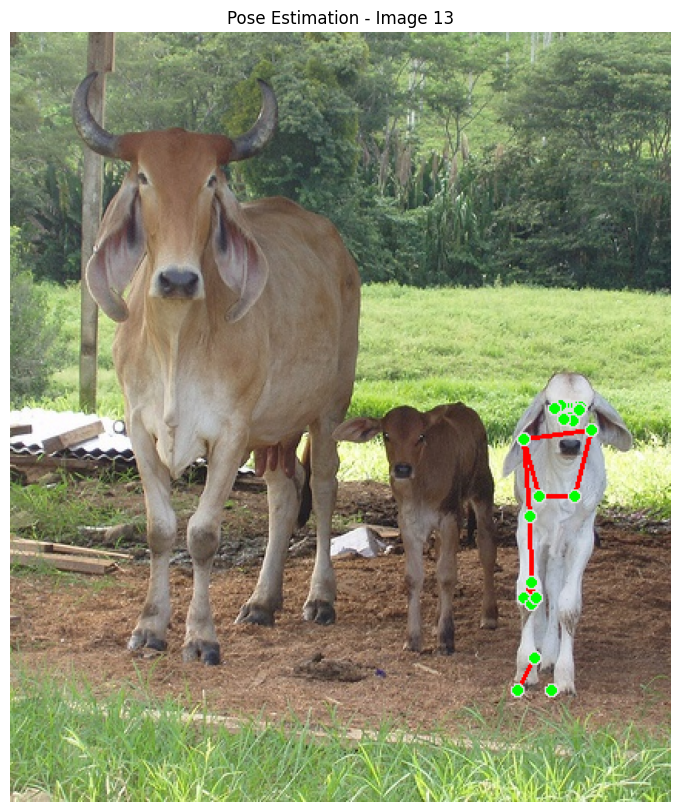

Landmarks for Image 13:
Landmark 0: x=0.85, y=0.50, z=-0.59, visibility=1.00
Landmark 1: x=0.86, y=0.49, z=-0.58, visibility=1.00
Landmark 2: x=0.86, y=0.49, z=-0.59, visibility=0.99
Landmark 3: x=0.86, y=0.49, z=-0.59, visibility=1.00
Landmark 4: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 5: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 6: x=0.83, y=0.49, z=-0.59, visibility=1.00
Landmark 7: x=0.86, y=0.49, z=-0.49, visibility=0.99
Landmark 8: x=0.82, y=0.49, z=-0.52, visibility=1.00
Landmark 9: x=0.85, y=0.51, z=-0.54, visibility=1.00
Landmark 10: x=0.84, y=0.50, z=-0.55, visibility=1.00
Landmark 11: x=0.88, y=0.52, z=-0.37, visibility=1.00
Landmark 12: x=0.78, y=0.53, z=-0.40, visibility=1.00
Landmark 13: x=0.91, y=0.53, z=-0.23, visibility=0.36
Landmark 14: x=0.79, y=0.63, z=-0.39, visibility=0.90
Landmark 15: x=0.87, y=0.49, z=-0.10, visibility=0.10
Landmark 16: x=0.79, y=0.72, z=-0.44, visibility=0.82
Landmark 17: x=0.86, y=0.50, z=-0.10, visibility=0.06
Landmark 18: x

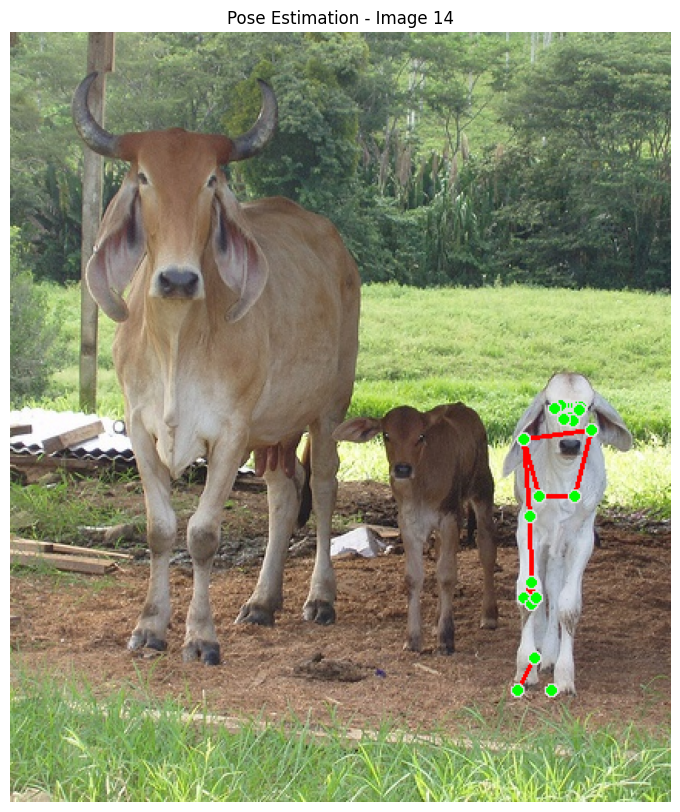

Landmarks for Image 14:
Landmark 0: x=0.85, y=0.50, z=-0.59, visibility=1.00
Landmark 1: x=0.86, y=0.49, z=-0.58, visibility=1.00
Landmark 2: x=0.86, y=0.49, z=-0.59, visibility=0.99
Landmark 3: x=0.86, y=0.49, z=-0.59, visibility=1.00
Landmark 4: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 5: x=0.84, y=0.49, z=-0.59, visibility=1.00
Landmark 6: x=0.83, y=0.49, z=-0.59, visibility=1.00
Landmark 7: x=0.86, y=0.49, z=-0.49, visibility=0.99
Landmark 8: x=0.82, y=0.49, z=-0.52, visibility=1.00
Landmark 9: x=0.85, y=0.51, z=-0.54, visibility=1.00
Landmark 10: x=0.84, y=0.50, z=-0.55, visibility=1.00
Landmark 11: x=0.88, y=0.52, z=-0.37, visibility=1.00
Landmark 12: x=0.78, y=0.53, z=-0.40, visibility=1.00
Landmark 13: x=0.91, y=0.53, z=-0.23, visibility=0.36
Landmark 14: x=0.79, y=0.63, z=-0.39, visibility=0.90
Landmark 15: x=0.87, y=0.49, z=-0.10, visibility=0.10
Landmark 16: x=0.79, y=0.72, z=-0.44, visibility=0.82
Landmark 17: x=0.86, y=0.50, z=-0.10, visibility=0.06
Landmark 18: x

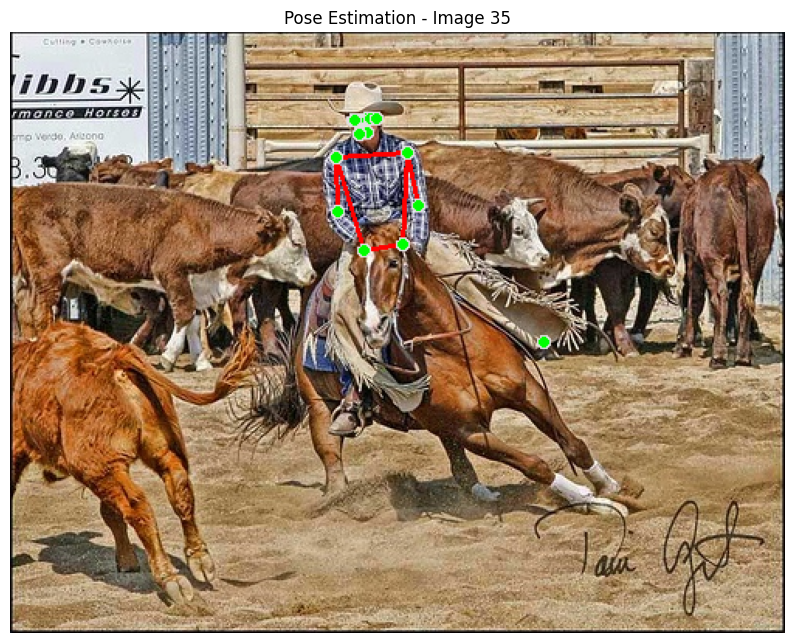

Landmarks for Image 35:
Landmark 0: x=0.45, y=0.16, z=-0.50, visibility=1.00
Landmark 1: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 2: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 3: x=0.47, y=0.14, z=-0.49, visibility=1.00
Landmark 4: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 5: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 6: x=0.44, y=0.15, z=-0.49, visibility=1.00
Landmark 7: x=0.47, y=0.15, z=-0.37, visibility=1.00
Landmark 8: x=0.44, y=0.15, z=-0.36, visibility=1.00
Landmark 9: x=0.46, y=0.17, z=-0.45, visibility=1.00
Landmark 10: x=0.45, y=0.17, z=-0.45, visibility=1.00
Landmark 11: x=0.51, y=0.20, z=-0.25, visibility=1.00
Landmark 12: x=0.42, y=0.21, z=-0.25, visibility=1.00
Landmark 13: x=0.53, y=0.29, z=-0.25, visibility=0.59
Landmark 14: x=0.42, y=0.30, z=-0.28, visibility=0.56
Landmark 15: x=0.52, y=0.36, z=-0.36, visibility=0.21
Landmark 16: x=0.46, y=0.35, z=-0.40, visibility=0.19
Landmark 17: x=0.52, y=0.38, z=-0.39, visibility=0.21
Landmark 18: x

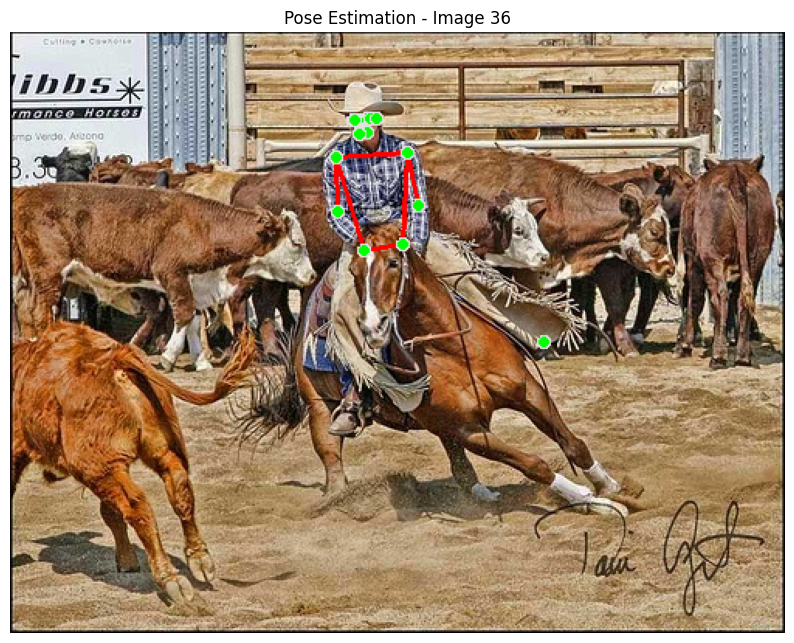

Landmarks for Image 36:
Landmark 0: x=0.45, y=0.16, z=-0.50, visibility=1.00
Landmark 1: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 2: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 3: x=0.47, y=0.14, z=-0.49, visibility=1.00
Landmark 4: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 5: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 6: x=0.44, y=0.15, z=-0.49, visibility=1.00
Landmark 7: x=0.47, y=0.15, z=-0.37, visibility=1.00
Landmark 8: x=0.44, y=0.15, z=-0.36, visibility=1.00
Landmark 9: x=0.46, y=0.17, z=-0.45, visibility=1.00
Landmark 10: x=0.45, y=0.17, z=-0.45, visibility=1.00
Landmark 11: x=0.51, y=0.20, z=-0.25, visibility=1.00
Landmark 12: x=0.42, y=0.21, z=-0.25, visibility=1.00
Landmark 13: x=0.53, y=0.29, z=-0.25, visibility=0.59
Landmark 14: x=0.42, y=0.30, z=-0.28, visibility=0.56
Landmark 15: x=0.52, y=0.36, z=-0.36, visibility=0.21
Landmark 16: x=0.46, y=0.35, z=-0.40, visibility=0.19
Landmark 17: x=0.52, y=0.38, z=-0.39, visibility=0.21
Landmark 18: x

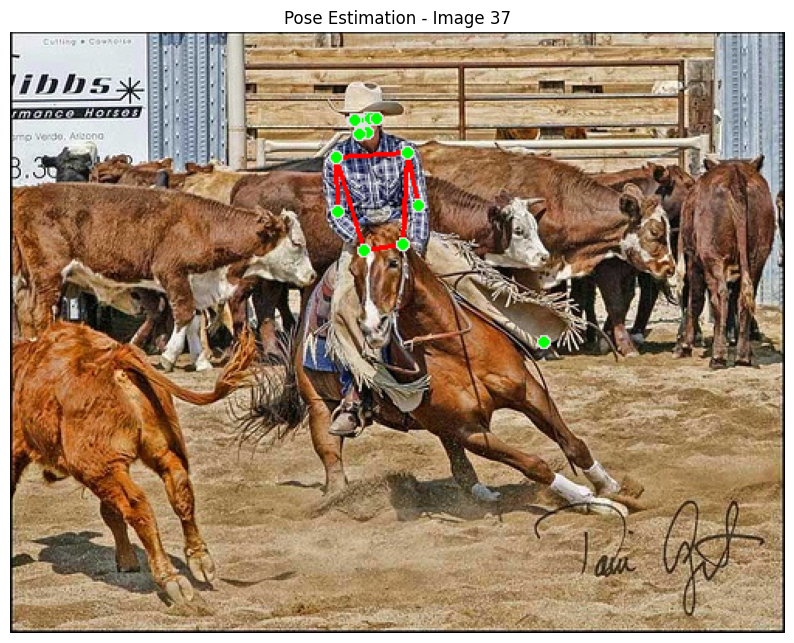

Landmarks for Image 37:
Landmark 0: x=0.45, y=0.16, z=-0.50, visibility=1.00
Landmark 1: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 2: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 3: x=0.47, y=0.14, z=-0.49, visibility=1.00
Landmark 4: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 5: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 6: x=0.44, y=0.15, z=-0.49, visibility=1.00
Landmark 7: x=0.47, y=0.15, z=-0.37, visibility=1.00
Landmark 8: x=0.44, y=0.15, z=-0.36, visibility=1.00
Landmark 9: x=0.46, y=0.17, z=-0.45, visibility=1.00
Landmark 10: x=0.45, y=0.17, z=-0.45, visibility=1.00
Landmark 11: x=0.51, y=0.20, z=-0.25, visibility=1.00
Landmark 12: x=0.42, y=0.21, z=-0.25, visibility=1.00
Landmark 13: x=0.53, y=0.29, z=-0.25, visibility=0.59
Landmark 14: x=0.42, y=0.30, z=-0.28, visibility=0.56
Landmark 15: x=0.52, y=0.36, z=-0.36, visibility=0.21
Landmark 16: x=0.46, y=0.35, z=-0.40, visibility=0.19
Landmark 17: x=0.52, y=0.38, z=-0.39, visibility=0.21
Landmark 18: x

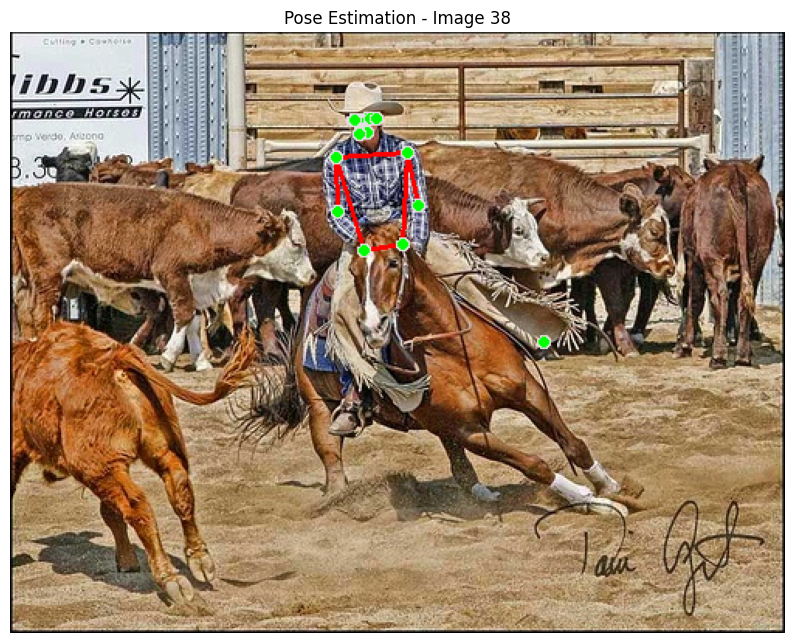

Landmarks for Image 38:
Landmark 0: x=0.45, y=0.16, z=-0.50, visibility=1.00
Landmark 1: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 2: x=0.46, y=0.15, z=-0.49, visibility=1.00
Landmark 3: x=0.47, y=0.14, z=-0.49, visibility=1.00
Landmark 4: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 5: x=0.45, y=0.15, z=-0.48, visibility=1.00
Landmark 6: x=0.44, y=0.15, z=-0.49, visibility=1.00
Landmark 7: x=0.47, y=0.15, z=-0.37, visibility=1.00
Landmark 8: x=0.44, y=0.15, z=-0.36, visibility=1.00
Landmark 9: x=0.46, y=0.17, z=-0.45, visibility=1.00
Landmark 10: x=0.45, y=0.17, z=-0.45, visibility=1.00
Landmark 11: x=0.51, y=0.20, z=-0.25, visibility=1.00
Landmark 12: x=0.42, y=0.21, z=-0.25, visibility=1.00
Landmark 13: x=0.53, y=0.29, z=-0.25, visibility=0.59
Landmark 14: x=0.42, y=0.30, z=-0.28, visibility=0.56
Landmark 15: x=0.52, y=0.36, z=-0.36, visibility=0.21
Landmark 16: x=0.46, y=0.35, z=-0.40, visibility=0.19
Landmark 17: x=0.52, y=0.38, z=-0.39, visibility=0.21
Landmark 18: x

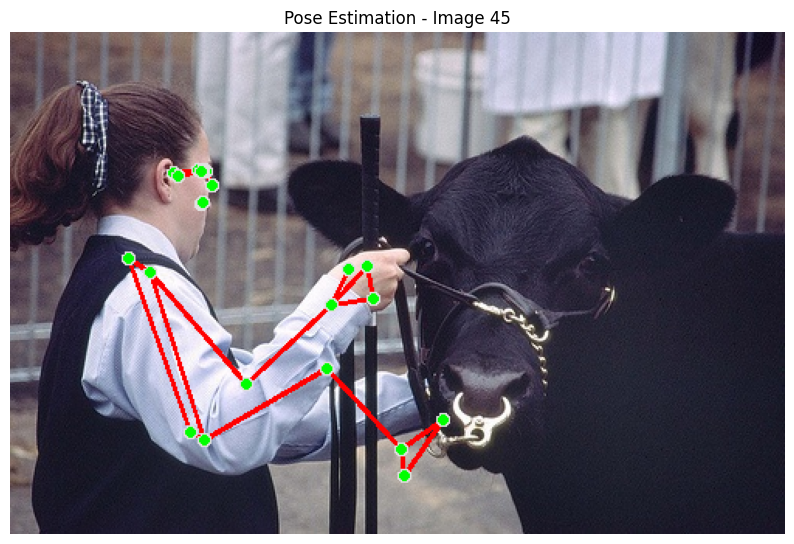

Landmarks for Image 45:
Landmark 0: x=0.26, y=0.31, z=-0.07, visibility=1.00
Landmark 1: x=0.25, y=0.28, z=-0.07, visibility=1.00
Landmark 2: x=0.25, y=0.28, z=-0.07, visibility=1.00
Landmark 3: x=0.24, y=0.27, z=-0.07, visibility=1.00
Landmark 4: x=0.25, y=0.28, z=-0.11, visibility=1.00
Landmark 5: x=0.25, y=0.28, z=-0.11, visibility=1.00
Landmark 6: x=0.25, y=0.28, z=-0.11, visibility=1.00
Landmark 7: x=0.21, y=0.28, z=-0.04, visibility=1.00
Landmark 8: x=0.22, y=0.29, z=-0.22, visibility=1.00
Landmark 9: x=0.25, y=0.34, z=-0.05, visibility=1.00
Landmark 10: x=0.25, y=0.34, z=-0.10, visibility=1.00
Landmark 11: x=0.15, y=0.45, z=0.05, visibility=1.00
Landmark 12: x=0.18, y=0.48, z=-0.26, visibility=1.00
Landmark 13: x=0.24, y=0.61, z=0.11, visibility=0.14
Landmark 14: x=0.31, y=0.70, z=-0.33, visibility=0.98
Landmark 15: x=0.37, y=0.59, z=0.09, visibility=0.11
Landmark 16: x=0.41, y=0.55, z=-0.28, visibility=0.98
Landmark 17: x=0.39, y=0.57, z=0.09, visibility=0.15
Landmark 18: x=0.4

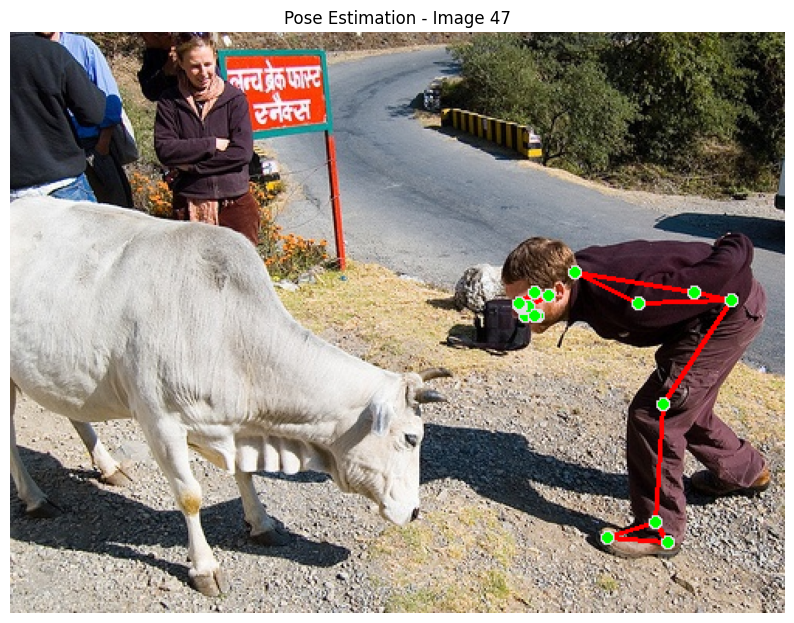

Landmarks for Image 47:
Landmark 0: x=0.67, y=0.49, z=-0.18, visibility=1.00
Landmark 1: x=0.66, y=0.48, z=-0.20, visibility=1.00
Landmark 2: x=0.67, y=0.47, z=-0.20, visibility=1.00
Landmark 3: x=0.67, y=0.47, z=-0.20, visibility=1.00
Landmark 4: x=0.66, y=0.47, z=-0.18, visibility=1.00
Landmark 5: x=0.66, y=0.47, z=-0.18, visibility=1.00
Landmark 6: x=0.66, y=0.47, z=-0.18, visibility=1.00
Landmark 7: x=0.69, y=0.45, z=-0.25, visibility=1.00
Landmark 8: x=0.68, y=0.45, z=-0.16, visibility=1.00
Landmark 9: x=0.68, y=0.49, z=-0.19, visibility=1.00
Landmark 10: x=0.68, y=0.49, z=-0.17, visibility=1.00
Landmark 11: x=0.81, y=0.47, z=-0.25, visibility=1.00
Landmark 12: x=0.73, y=0.42, z=-0.07, visibility=1.00
Landmark 13: x=0.91, y=0.41, z=-0.17, visibility=0.31
Landmark 14: x=0.83, y=0.39, z=0.04, visibility=0.00
Landmark 15: x=0.92, y=0.40, z=-0.06, visibility=0.07
Landmark 16: x=0.88, y=0.40, z=0.07, visibility=0.00
Landmark 17: x=0.94, y=0.38, z=-0.07, visibility=0.09
Landmark 18: x=0

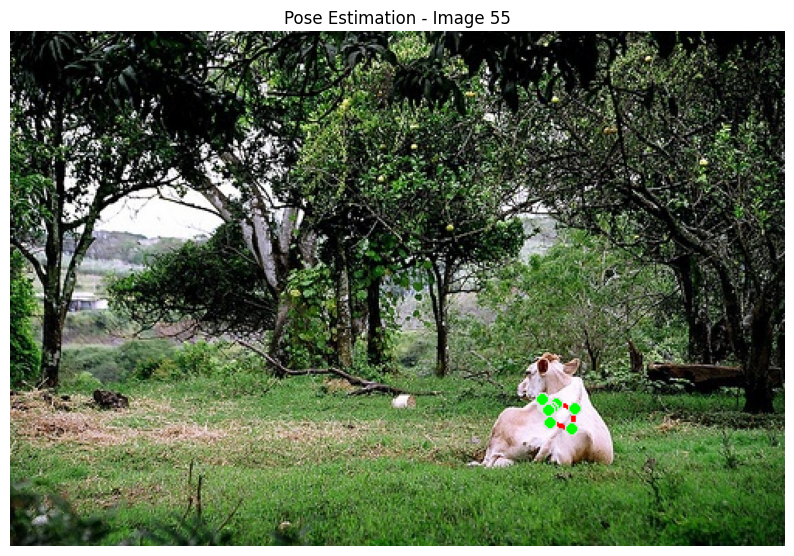

Landmarks for Image 55:
Landmark 0: x=0.69, y=0.73, z=-0.17, visibility=1.00
Landmark 1: x=0.70, y=0.73, z=-0.18, visibility=1.00
Landmark 2: x=0.70, y=0.73, z=-0.18, visibility=1.00
Landmark 3: x=0.70, y=0.73, z=-0.18, visibility=1.00
Landmark 4: x=0.69, y=0.73, z=-0.18, visibility=1.00
Landmark 5: x=0.69, y=0.73, z=-0.18, visibility=1.00
Landmark 6: x=0.69, y=0.73, z=-0.18, visibility=1.00
Landmark 7: x=0.70, y=0.72, z=-0.17, visibility=1.00
Landmark 8: x=0.69, y=0.72, z=-0.15, visibility=1.00
Landmark 9: x=0.70, y=0.73, z=-0.16, visibility=0.99
Landmark 10: x=0.69, y=0.74, z=-0.16, visibility=0.98
Landmark 11: x=0.73, y=0.73, z=-0.14, visibility=1.00
Landmark 12: x=0.69, y=0.71, z=-0.12, visibility=1.00
Landmark 13: x=0.73, y=0.78, z=-0.14, visibility=0.05
Landmark 14: x=0.68, y=0.72, z=-0.13, visibility=0.04
Landmark 15: x=0.73, y=0.81, z=-0.16, visibility=0.04
Landmark 16: x=0.66, y=0.72, z=-0.15, visibility=0.02
Landmark 17: x=0.73, y=0.81, z=-0.18, visibility=0.05
Landmark 18: x

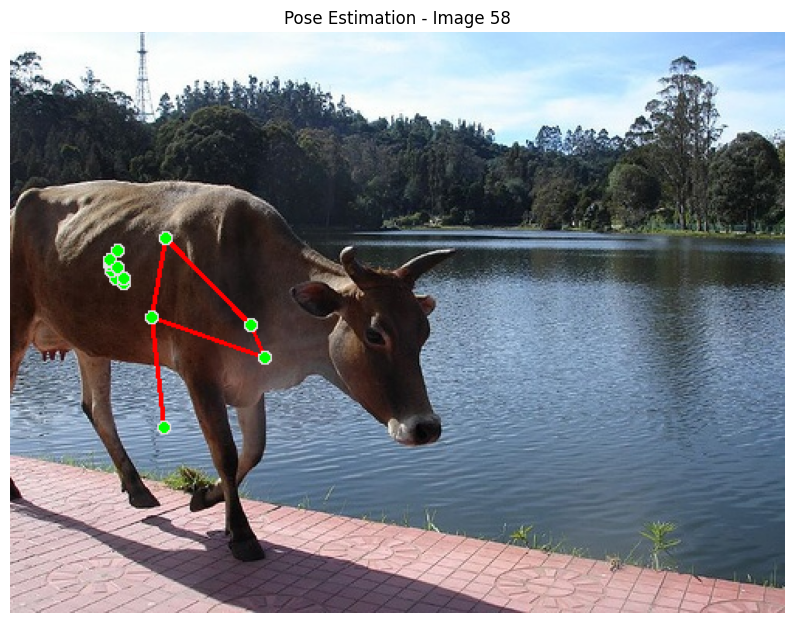

Landmarks for Image 58:
Landmark 0: x=0.14, y=0.42, z=-0.32, visibility=1.00
Landmark 1: x=0.13, y=0.41, z=-0.36, visibility=1.00
Landmark 2: x=0.13, y=0.41, z=-0.36, visibility=1.00
Landmark 3: x=0.13, y=0.41, z=-0.36, visibility=1.00
Landmark 4: x=0.13, y=0.40, z=-0.34, visibility=1.00
Landmark 5: x=0.13, y=0.40, z=-0.34, visibility=1.00
Landmark 6: x=0.13, y=0.39, z=-0.34, visibility=1.00
Landmark 7: x=0.14, y=0.41, z=-0.43, visibility=1.00
Landmark 8: x=0.14, y=0.38, z=-0.35, visibility=1.00
Landmark 9: x=0.15, y=0.43, z=-0.33, visibility=1.00
Landmark 10: x=0.15, y=0.42, z=-0.31, visibility=1.00
Landmark 11: x=0.18, y=0.49, z=-0.44, visibility=1.00
Landmark 12: x=0.20, y=0.36, z=-0.26, visibility=1.00
Landmark 13: x=0.20, y=0.68, z=-0.47, visibility=0.60
Landmark 14: x=0.31, y=0.40, z=-0.23, visibility=0.01
Landmark 15: x=0.19, y=0.81, z=-0.40, visibility=0.37
Landmark 16: x=0.41, y=0.44, z=-0.20, visibility=0.00
Landmark 17: x=0.19, y=0.82, z=-0.44, visibility=0.29
Landmark 18: x

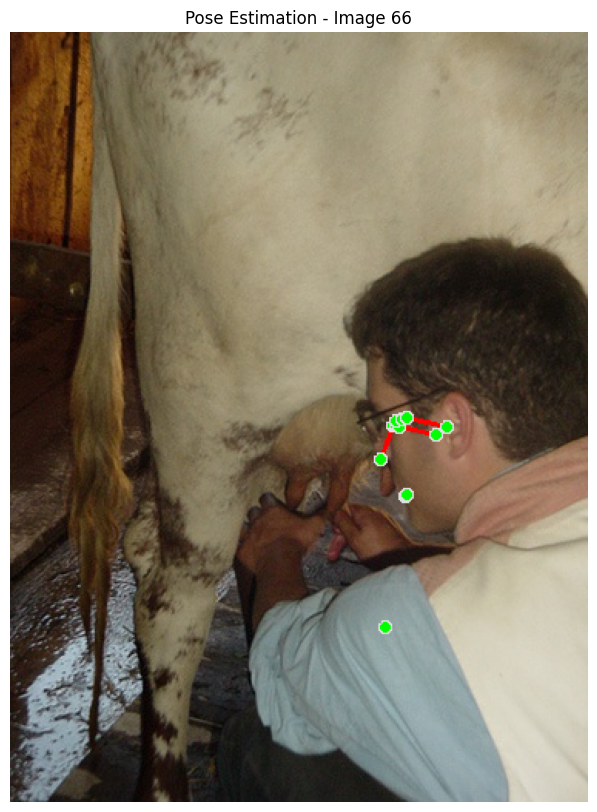

Landmarks for Image 66:
Landmark 0: x=0.64, y=0.56, z=0.00, visibility=1.00
Landmark 1: x=0.66, y=0.51, z=-0.15, visibility=1.00
Landmark 2: x=0.67, y=0.51, z=-0.15, visibility=1.00
Landmark 3: x=0.67, y=0.51, z=-0.15, visibility=1.00
Landmark 4: x=0.67, y=0.51, z=-0.03, visibility=1.00
Landmark 5: x=0.68, y=0.50, z=-0.03, visibility=1.00
Landmark 6: x=0.69, y=0.50, z=-0.03, visibility=1.00
Landmark 7: x=0.74, y=0.52, z=-0.55, visibility=1.00
Landmark 8: x=0.76, y=0.51, z=-0.04, visibility=1.00
Landmark 9: x=0.68, y=0.60, z=-0.10, visibility=0.99
Landmark 10: x=0.69, y=0.60, z=0.04, visibility=1.00
Landmark 11: x=0.65, y=0.77, z=-0.69, visibility=0.98
Landmark 12: x=1.00, y=0.68, z=0.26, visibility=0.99
Landmark 13: x=0.49, y=0.88, z=-0.47, visibility=0.10
Landmark 14: x=0.88, y=0.78, z=0.97, visibility=0.00
Landmark 15: x=0.53, y=0.73, z=0.27, visibility=0.04
Landmark 16: x=0.66, y=0.70, z=1.61, visibility=0.03
Landmark 17: x=0.51, y=0.71, z=0.29, visibility=0.08
Landmark 18: x=0.62, 

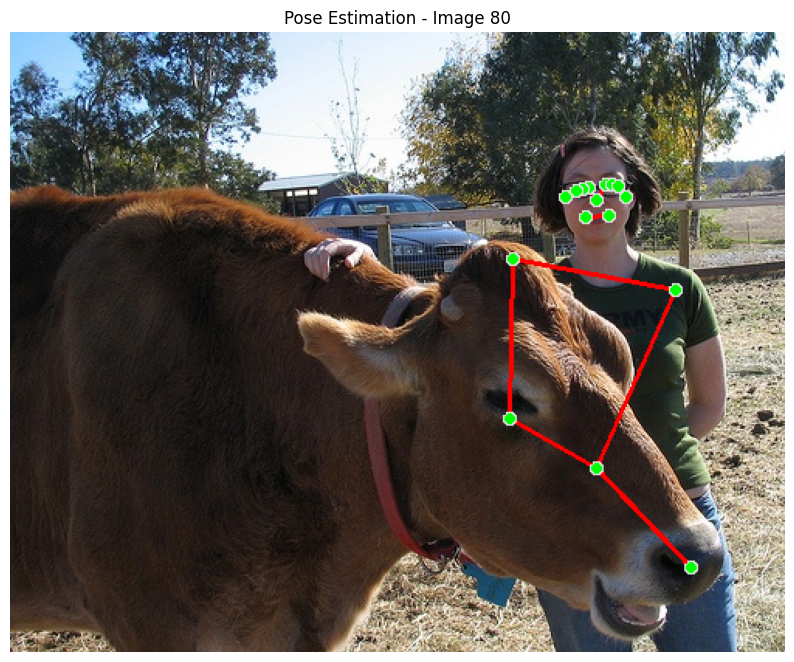

Landmarks for Image 80:
Landmark 0: x=0.76, y=0.27, z=-0.17, visibility=1.00
Landmark 1: x=0.77, y=0.25, z=-0.13, visibility=0.99
Landmark 2: x=0.78, y=0.25, z=-0.13, visibility=0.99
Landmark 3: x=0.78, y=0.25, z=-0.13, visibility=0.99
Landmark 4: x=0.75, y=0.25, z=-0.13, visibility=1.00
Landmark 5: x=0.74, y=0.25, z=-0.13, visibility=1.00
Landmark 6: x=0.73, y=0.26, z=-0.13, visibility=1.00
Landmark 7: x=0.79, y=0.27, z=0.04, visibility=1.00
Landmark 8: x=0.72, y=0.27, z=0.05, visibility=1.00
Landmark 9: x=0.77, y=0.30, z=-0.10, visibility=1.00
Landmark 10: x=0.74, y=0.30, z=-0.11, visibility=1.00
Landmark 11: x=0.86, y=0.42, z=0.08, visibility=1.00
Landmark 12: x=0.65, y=0.37, z=0.08, visibility=1.00
Landmark 13: x=0.89, y=0.62, z=-0.04, visibility=0.20
Landmark 14: x=0.58, y=0.50, z=-0.17, visibility=0.16
Landmark 15: x=0.80, y=0.60, z=-0.25, visibility=0.02
Landmark 16: x=0.70, y=0.54, z=-0.48, visibility=0.06
Landmark 17: x=0.77, y=0.63, z=-0.29, visibility=0.03
Landmark 18: x=0.7

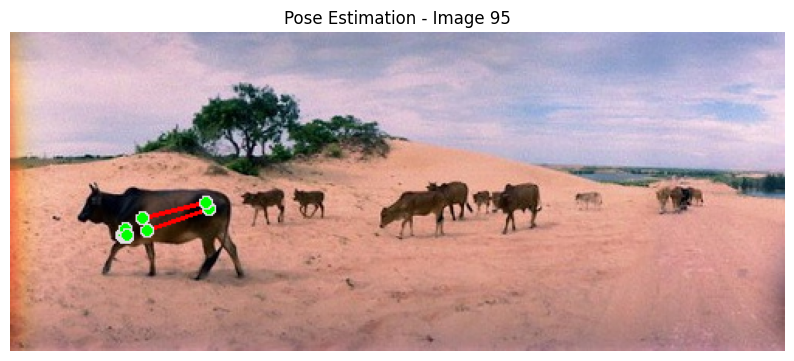

Landmarks for Image 95:
Landmark 0: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 1: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 2: x=0.15, y=0.64, z=-0.11, visibility=0.99
Landmark 3: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 4: x=0.15, y=0.64, z=-0.09, visibility=1.00
Landmark 5: x=0.15, y=0.64, z=-0.09, visibility=0.99
Landmark 6: x=0.15, y=0.63, z=-0.09, visibility=1.00
Landmark 7: x=0.15, y=0.62, z=-0.14, visibility=0.99
Landmark 8: x=0.15, y=0.62, z=-0.06, visibility=0.99
Landmark 9: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 10: x=0.15, y=0.64, z=-0.08, visibility=0.98
Landmark 11: x=0.18, y=0.63, z=-0.17, visibility=1.00
Landmark 12: x=0.17, y=0.58, z=0.01, visibility=1.00
Landmark 13: x=0.16, y=0.66, z=-0.21, visibility=0.17
Landmark 14: x=0.15, y=0.61, z=0.06, visibility=0.02
Landmark 15: x=0.15, y=0.68, z=-0.22, visibility=0.21
Landmark 16: x=0.13, y=0.63, z=0.05, visibility=0.07
Landmark 17: x=0.15, y=0.68, z=-0.24, visibility=0.22
Landmark 18: x=0.

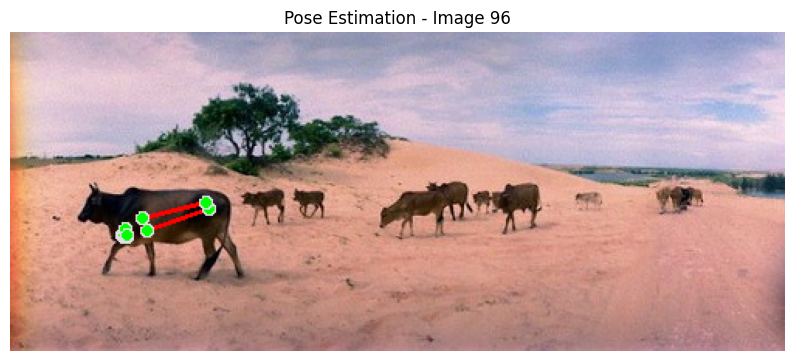

Landmarks for Image 96:
Landmark 0: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 1: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 2: x=0.15, y=0.64, z=-0.11, visibility=0.99
Landmark 3: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 4: x=0.15, y=0.64, z=-0.09, visibility=1.00
Landmark 5: x=0.15, y=0.64, z=-0.09, visibility=0.99
Landmark 6: x=0.15, y=0.63, z=-0.09, visibility=1.00
Landmark 7: x=0.15, y=0.62, z=-0.14, visibility=0.99
Landmark 8: x=0.15, y=0.62, z=-0.06, visibility=0.99
Landmark 9: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 10: x=0.15, y=0.64, z=-0.08, visibility=0.98
Landmark 11: x=0.18, y=0.63, z=-0.17, visibility=1.00
Landmark 12: x=0.17, y=0.58, z=0.01, visibility=1.00
Landmark 13: x=0.16, y=0.66, z=-0.21, visibility=0.17
Landmark 14: x=0.15, y=0.61, z=0.06, visibility=0.02
Landmark 15: x=0.15, y=0.68, z=-0.22, visibility=0.21
Landmark 16: x=0.13, y=0.63, z=0.05, visibility=0.07
Landmark 17: x=0.15, y=0.68, z=-0.24, visibility=0.22
Landmark 18: x=0.

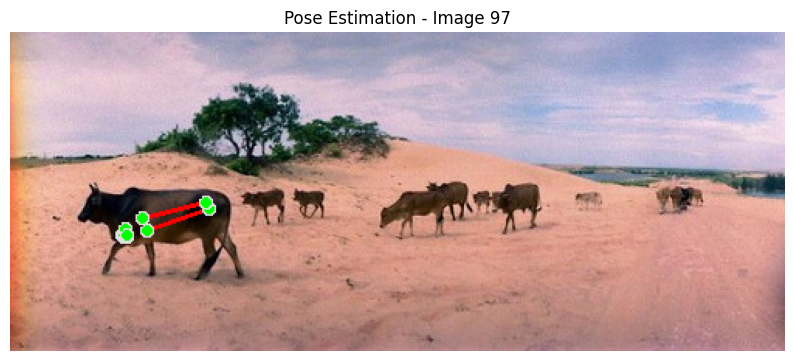

Landmarks for Image 97:
Landmark 0: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 1: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 2: x=0.15, y=0.64, z=-0.11, visibility=0.99
Landmark 3: x=0.15, y=0.64, z=-0.11, visibility=1.00
Landmark 4: x=0.15, y=0.64, z=-0.09, visibility=1.00
Landmark 5: x=0.15, y=0.64, z=-0.09, visibility=0.99
Landmark 6: x=0.15, y=0.63, z=-0.09, visibility=1.00
Landmark 7: x=0.15, y=0.62, z=-0.14, visibility=0.99
Landmark 8: x=0.15, y=0.62, z=-0.06, visibility=0.99
Landmark 9: x=0.15, y=0.64, z=-0.10, visibility=0.99
Landmark 10: x=0.15, y=0.64, z=-0.08, visibility=0.98
Landmark 11: x=0.18, y=0.63, z=-0.17, visibility=1.00
Landmark 12: x=0.17, y=0.58, z=0.01, visibility=1.00
Landmark 13: x=0.16, y=0.66, z=-0.21, visibility=0.17
Landmark 14: x=0.15, y=0.61, z=0.06, visibility=0.02
Landmark 15: x=0.15, y=0.68, z=-0.22, visibility=0.21
Landmark 16: x=0.13, y=0.63, z=0.05, visibility=0.07
Landmark 17: x=0.15, y=0.68, z=-0.24, visibility=0.22
Landmark 18: x=0.

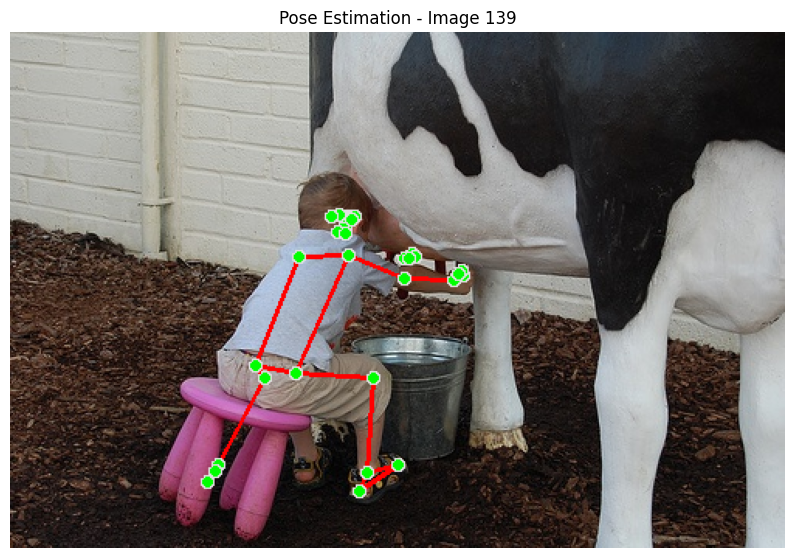

Landmarks for Image 139:
Landmark 0: x=0.43, y=0.38, z=0.30, visibility=1.00
Landmark 1: x=0.43, y=0.36, z=0.29, visibility=1.00
Landmark 2: x=0.43, y=0.36, z=0.29, visibility=1.00
Landmark 3: x=0.42, y=0.36, z=0.29, visibility=1.00
Landmark 4: x=0.44, y=0.36, z=0.27, visibility=1.00
Landmark 5: x=0.44, y=0.36, z=0.27, visibility=1.00
Landmark 6: x=0.44, y=0.36, z=0.27, visibility=1.00
Landmark 7: x=0.42, y=0.36, z=0.21, visibility=1.00
Landmark 8: x=0.44, y=0.36, z=0.13, visibility=1.00
Landmark 9: x=0.42, y=0.39, z=0.29, visibility=1.00
Landmark 10: x=0.43, y=0.39, z=0.26, visibility=1.00
Landmark 11: x=0.37, y=0.44, z=0.25, visibility=1.00
Landmark 12: x=0.44, y=0.44, z=0.00, visibility=1.00
Landmark 13: x=0.43, y=0.47, z=0.38, visibility=0.05
Landmark 14: x=0.51, y=0.48, z=0.05, visibility=1.00
Landmark 15: x=0.51, y=0.44, z=0.56, visibility=0.95
Landmark 16: x=0.57, y=0.48, z=0.25, visibility=1.00
Landmark 17: x=0.52, y=0.43, z=0.60, visibility=0.97
Landmark 18: x=0.59, y=0.47, z=

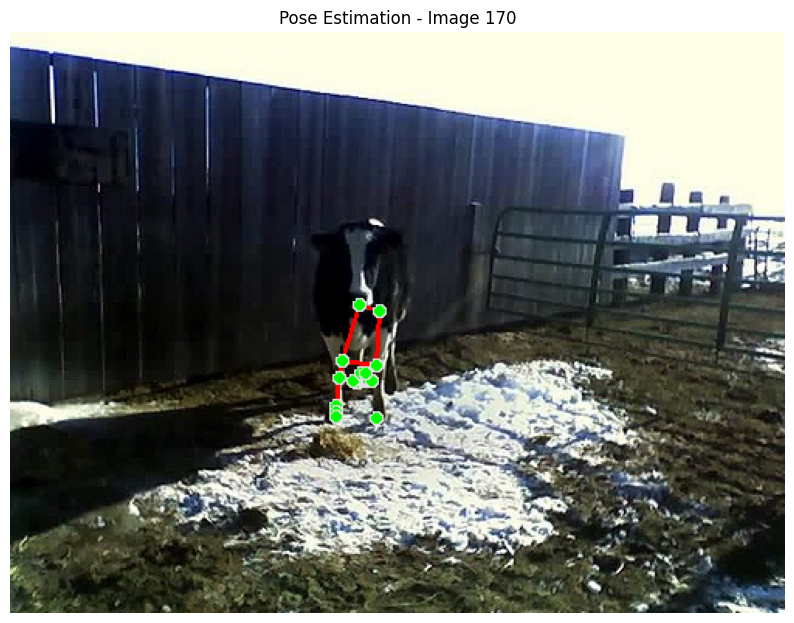

Landmarks for Image 170:
Landmark 0: x=0.45, y=0.59, z=-0.17, visibility=1.00
Landmark 1: x=0.45, y=0.60, z=-0.16, visibility=1.00
Landmark 2: x=0.45, y=0.60, z=-0.16, visibility=0.99
Landmark 3: x=0.45, y=0.60, z=-0.16, visibility=1.00
Landmark 4: x=0.46, y=0.60, z=-0.16, visibility=1.00
Landmark 5: x=0.46, y=0.60, z=-0.16, visibility=1.00
Landmark 6: x=0.46, y=0.60, z=-0.16, visibility=1.00
Landmark 7: x=0.44, y=0.60, z=-0.11, visibility=1.00
Landmark 8: x=0.47, y=0.60, z=-0.10, visibility=0.99
Landmark 9: x=0.45, y=0.59, z=-0.15, visibility=0.98
Landmark 10: x=0.46, y=0.59, z=-0.15, visibility=0.98
Landmark 11: x=0.43, y=0.57, z=-0.09, visibility=1.00
Landmark 12: x=0.47, y=0.57, z=-0.07, visibility=1.00
Landmark 13: x=0.42, y=0.60, z=-0.14, visibility=0.58
Landmark 14: x=0.48, y=0.62, z=-0.11, visibility=0.48
Landmark 15: x=0.42, y=0.64, z=-0.19, visibility=0.56
Landmark 16: x=0.47, y=0.66, z=-0.17, visibility=0.54
Landmark 17: x=0.42, y=0.66, z=-0.21, visibility=0.51
Landmark 18: 

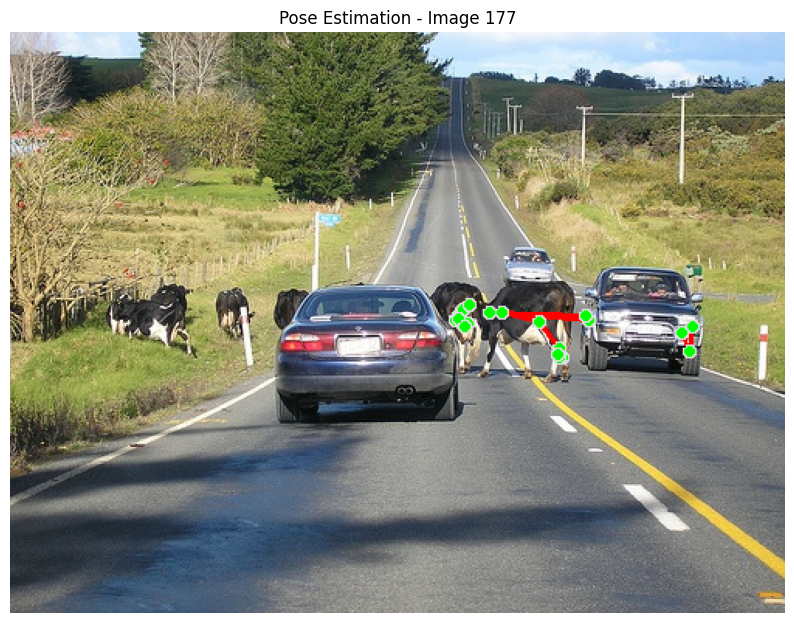

Landmarks for Image 177:
Landmark 0: x=0.58, y=0.50, z=-0.15, visibility=1.00
Landmark 1: x=0.58, y=0.49, z=-0.15, visibility=1.00
Landmark 2: x=0.58, y=0.48, z=-0.15, visibility=1.00
Landmark 3: x=0.59, y=0.48, z=-0.15, visibility=1.00
Landmark 4: x=0.58, y=0.49, z=-0.13, visibility=1.00
Landmark 5: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 6: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 7: x=0.59, y=0.47, z=-0.15, visibility=1.00
Landmark 8: x=0.58, y=0.49, z=-0.06, visibility=1.00
Landmark 9: x=0.59, y=0.50, z=-0.14, visibility=1.00
Landmark 10: x=0.59, y=0.51, z=-0.12, visibility=1.00
Landmark 11: x=0.64, y=0.49, z=-0.19, visibility=1.00
Landmark 12: x=0.62, y=0.48, z=0.06, visibility=1.00
Landmark 13: x=0.68, y=0.50, z=-0.26, visibility=0.92
Landmark 14: x=0.63, y=0.52, z=0.13, visibility=0.03
Landmark 15: x=0.71, y=0.55, z=-0.29, visibility=0.93
Landmark 16: x=0.63, y=0.54, z=0.12, visibility=0.25
Landmark 17: x=0.71, y=0.56, z=-0.32, visibility=0.91
Landmark 18: x=0

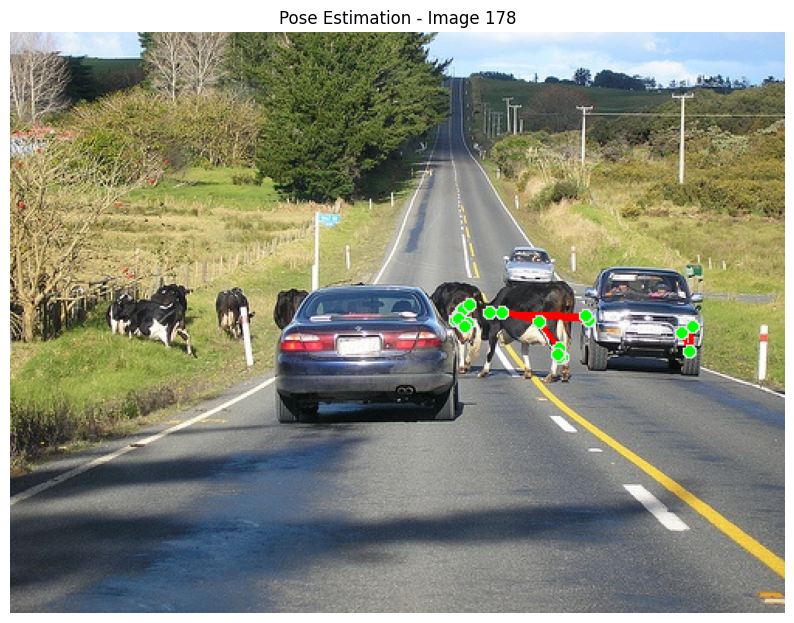

Landmarks for Image 178:
Landmark 0: x=0.58, y=0.50, z=-0.15, visibility=1.00
Landmark 1: x=0.58, y=0.49, z=-0.15, visibility=1.00
Landmark 2: x=0.58, y=0.48, z=-0.15, visibility=1.00
Landmark 3: x=0.59, y=0.48, z=-0.15, visibility=1.00
Landmark 4: x=0.58, y=0.49, z=-0.13, visibility=1.00
Landmark 5: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 6: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 7: x=0.59, y=0.47, z=-0.15, visibility=1.00
Landmark 8: x=0.58, y=0.49, z=-0.06, visibility=1.00
Landmark 9: x=0.59, y=0.50, z=-0.14, visibility=1.00
Landmark 10: x=0.59, y=0.51, z=-0.12, visibility=1.00
Landmark 11: x=0.64, y=0.49, z=-0.19, visibility=1.00
Landmark 12: x=0.62, y=0.48, z=0.06, visibility=1.00
Landmark 13: x=0.68, y=0.50, z=-0.26, visibility=0.92
Landmark 14: x=0.63, y=0.52, z=0.13, visibility=0.03
Landmark 15: x=0.71, y=0.55, z=-0.29, visibility=0.93
Landmark 16: x=0.63, y=0.54, z=0.12, visibility=0.25
Landmark 17: x=0.71, y=0.56, z=-0.32, visibility=0.91
Landmark 18: x=0

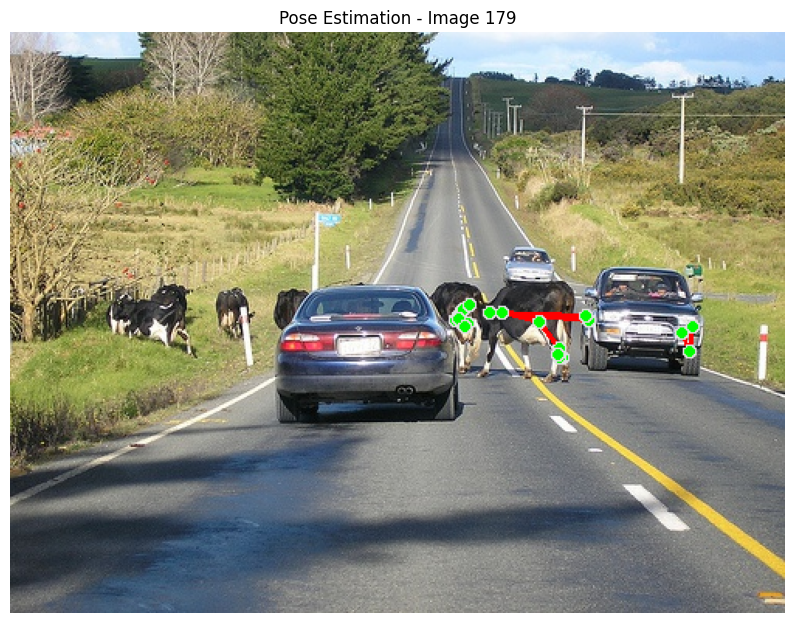

Landmarks for Image 179:
Landmark 0: x=0.58, y=0.50, z=-0.15, visibility=1.00
Landmark 1: x=0.58, y=0.49, z=-0.15, visibility=1.00
Landmark 2: x=0.58, y=0.48, z=-0.15, visibility=1.00
Landmark 3: x=0.59, y=0.48, z=-0.15, visibility=1.00
Landmark 4: x=0.58, y=0.49, z=-0.13, visibility=1.00
Landmark 5: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 6: x=0.58, y=0.50, z=-0.13, visibility=1.00
Landmark 7: x=0.59, y=0.47, z=-0.15, visibility=1.00
Landmark 8: x=0.58, y=0.49, z=-0.06, visibility=1.00
Landmark 9: x=0.59, y=0.50, z=-0.14, visibility=1.00
Landmark 10: x=0.59, y=0.51, z=-0.12, visibility=1.00
Landmark 11: x=0.64, y=0.49, z=-0.19, visibility=1.00
Landmark 12: x=0.62, y=0.48, z=0.06, visibility=1.00
Landmark 13: x=0.68, y=0.50, z=-0.26, visibility=0.92
Landmark 14: x=0.63, y=0.52, z=0.13, visibility=0.03
Landmark 15: x=0.71, y=0.55, z=-0.29, visibility=0.93
Landmark 16: x=0.63, y=0.54, z=0.12, visibility=0.25
Landmark 17: x=0.71, y=0.56, z=-0.32, visibility=0.91
Landmark 18: x=0

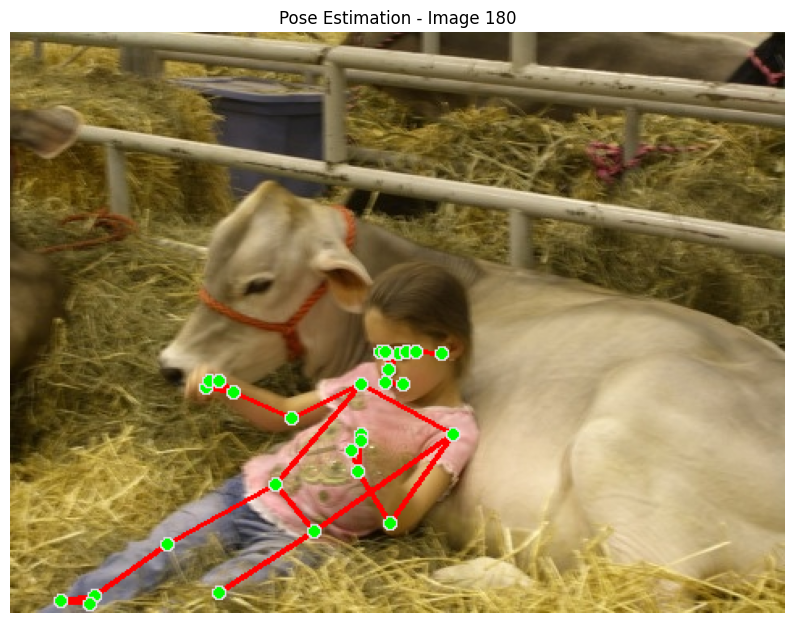

Landmarks for Image 180:
Landmark 0: x=0.49, y=0.58, z=-0.35, visibility=1.00
Landmark 1: x=0.50, y=0.55, z=-0.34, visibility=1.00
Landmark 2: x=0.51, y=0.55, z=-0.34, visibility=1.00
Landmark 3: x=0.52, y=0.55, z=-0.34, visibility=1.00
Landmark 4: x=0.49, y=0.55, z=-0.33, visibility=1.00
Landmark 5: x=0.48, y=0.55, z=-0.33, visibility=1.00
Landmark 6: x=0.48, y=0.55, z=-0.33, visibility=1.00
Landmark 7: x=0.56, y=0.55, z=-0.22, visibility=1.00
Landmark 8: x=0.48, y=0.55, z=-0.15, visibility=1.00
Landmark 9: x=0.51, y=0.61, z=-0.29, visibility=1.00
Landmark 10: x=0.48, y=0.60, z=-0.28, visibility=1.00
Landmark 11: x=0.57, y=0.69, z=-0.15, visibility=1.00
Landmark 12: x=0.45, y=0.61, z=0.01, visibility=1.00
Landmark 13: x=0.49, y=0.84, z=-0.30, visibility=0.99
Landmark 14: x=0.36, y=0.66, z=0.02, visibility=0.79
Landmark 15: x=0.45, y=0.76, z=-0.55, visibility=1.00
Landmark 16: x=0.29, y=0.62, z=-0.17, visibility=0.94
Landmark 17: x=0.44, y=0.72, z=-0.60, visibility=0.99
Landmark 18: x=

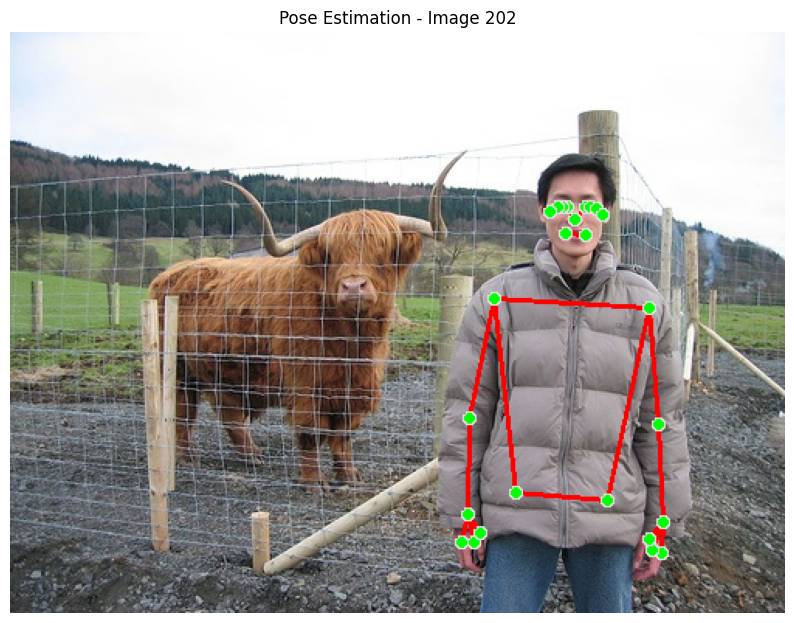

Landmarks for Image 202:
Landmark 0: x=0.73, y=0.33, z=-0.83, visibility=1.00
Landmark 1: x=0.74, y=0.30, z=-0.81, visibility=1.00
Landmark 2: x=0.75, y=0.30, z=-0.81, visibility=1.00
Landmark 3: x=0.76, y=0.30, z=-0.81, visibility=1.00
Landmark 4: x=0.72, y=0.30, z=-0.81, visibility=1.00
Landmark 5: x=0.71, y=0.30, z=-0.81, visibility=1.00
Landmark 6: x=0.71, y=0.30, z=-0.81, visibility=1.00
Landmark 7: x=0.76, y=0.32, z=-0.62, visibility=1.00
Landmark 8: x=0.70, y=0.31, z=-0.61, visibility=1.00
Landmark 9: x=0.74, y=0.35, z=-0.75, visibility=1.00
Landmark 10: x=0.72, y=0.35, z=-0.75, visibility=1.00
Landmark 11: x=0.83, y=0.47, z=-0.46, visibility=1.00
Landmark 12: x=0.63, y=0.46, z=-0.43, visibility=1.00
Landmark 13: x=0.84, y=0.68, z=-0.46, visibility=1.00
Landmark 14: x=0.59, y=0.67, z=-0.42, visibility=1.00
Landmark 15: x=0.84, y=0.84, z=-0.68, visibility=0.99
Landmark 16: x=0.59, y=0.83, z=-0.61, visibility=1.00
Landmark 17: x=0.84, y=0.90, z=-0.76, visibility=0.98
Landmark 18: 

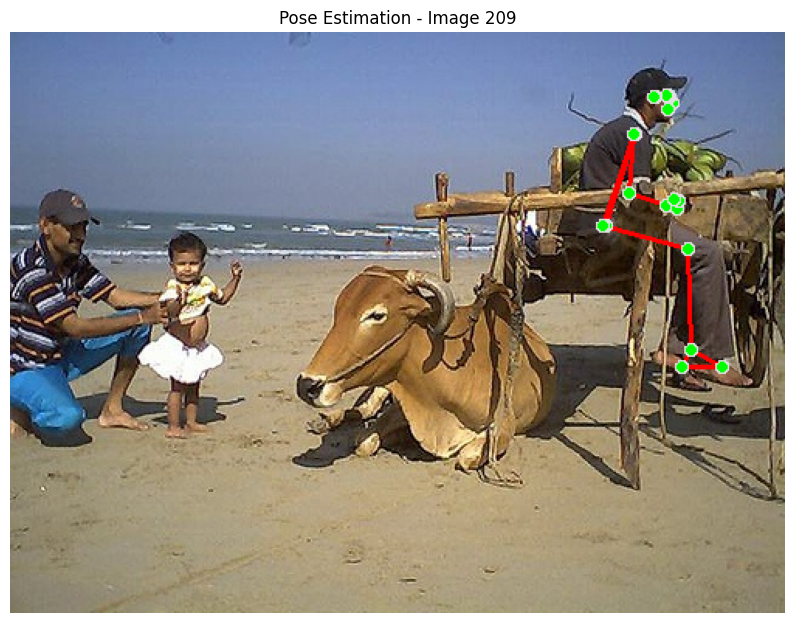

Landmarks for Image 209:
Landmark 0: x=0.86, y=0.12, z=-0.05, visibility=1.00
Landmark 1: x=0.85, y=0.11, z=-0.04, visibility=1.00
Landmark 2: x=0.85, y=0.11, z=-0.04, visibility=1.00
Landmark 3: x=0.85, y=0.11, z=-0.04, visibility=1.00
Landmark 4: x=0.85, y=0.11, z=-0.07, visibility=1.00
Landmark 5: x=0.85, y=0.11, z=-0.07, visibility=1.00
Landmark 6: x=0.85, y=0.11, z=-0.07, visibility=1.00
Landmark 7: x=0.83, y=0.11, z=0.02, visibility=1.00
Landmark 8: x=0.83, y=0.11, z=-0.11, visibility=1.00
Landmark 9: x=0.85, y=0.14, z=-0.03, visibility=1.00
Landmark 10: x=0.85, y=0.14, z=-0.07, visibility=1.00
Landmark 11: x=0.81, y=0.18, z=0.11, visibility=1.00
Landmark 12: x=0.80, y=0.18, z=-0.17, visibility=1.00
Landmark 13: x=0.80, y=0.27, z=0.07, visibility=0.05
Landmark 14: x=0.80, y=0.28, z=-0.25, visibility=0.89
Landmark 15: x=0.83, y=0.30, z=-0.10, visibility=0.08
Landmark 16: x=0.85, y=0.30, z=-0.25, visibility=0.73
Landmark 17: x=0.83, y=0.31, z=-0.12, visibility=0.14
Landmark 18: x=0

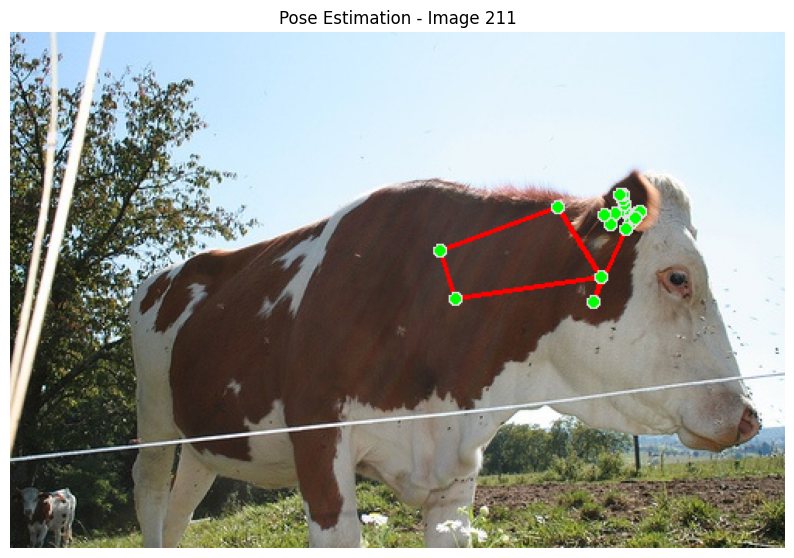

Landmarks for Image 211:
Landmark 0: x=0.78, y=0.35, z=-0.00, visibility=0.99
Landmark 1: x=0.80, y=0.35, z=0.01, visibility=0.99
Landmark 2: x=0.80, y=0.36, z=0.01, visibility=0.99
Landmark 3: x=0.80, y=0.36, z=0.01, visibility=0.99
Landmark 4: x=0.79, y=0.33, z=0.02, visibility=0.99
Landmark 5: x=0.79, y=0.33, z=0.02, visibility=0.99
Landmark 6: x=0.79, y=0.32, z=0.02, visibility=0.99
Landmark 7: x=0.80, y=0.37, z=0.08, visibility=0.99
Landmark 8: x=0.79, y=0.32, z=0.12, visibility=0.98
Landmark 9: x=0.77, y=0.37, z=0.02, visibility=0.99
Landmark 10: x=0.77, y=0.36, z=0.03, visibility=0.99
Landmark 11: x=0.76, y=0.48, z=0.07, visibility=1.00
Landmark 12: x=0.71, y=0.34, z=0.16, visibility=1.00
Landmark 13: x=0.75, y=0.53, z=-0.05, visibility=0.78
Landmark 14: x=0.60, y=0.36, z=0.14, visibility=0.05
Landmark 15: x=0.80, y=0.38, z=-0.17, visibility=0.84
Landmark 16: x=0.55, y=0.37, z=0.05, visibility=0.06
Landmark 17: x=0.81, y=0.35, z=-0.20, visibility=0.76
Landmark 18: x=0.53, y=0.37

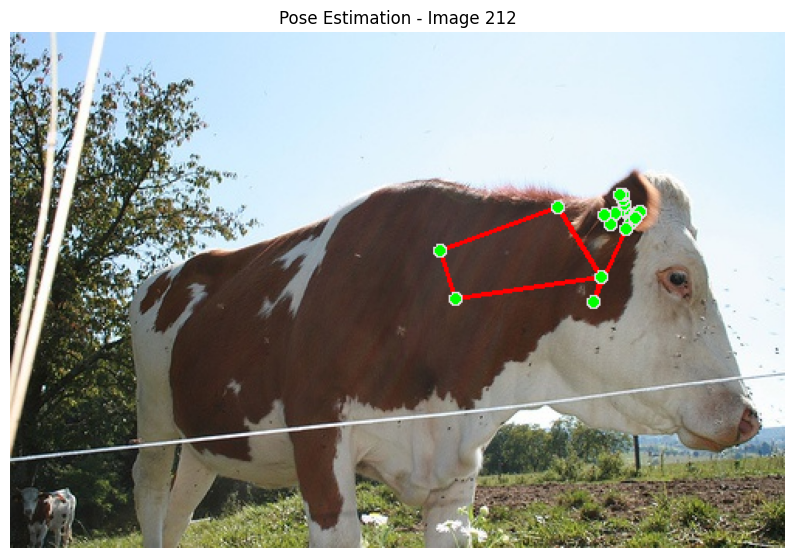

Landmarks for Image 212:
Landmark 0: x=0.78, y=0.35, z=-0.00, visibility=0.99
Landmark 1: x=0.80, y=0.35, z=0.01, visibility=0.99
Landmark 2: x=0.80, y=0.36, z=0.01, visibility=0.99
Landmark 3: x=0.80, y=0.36, z=0.01, visibility=0.99
Landmark 4: x=0.79, y=0.33, z=0.02, visibility=0.99
Landmark 5: x=0.79, y=0.33, z=0.02, visibility=0.99
Landmark 6: x=0.79, y=0.32, z=0.02, visibility=0.99
Landmark 7: x=0.80, y=0.37, z=0.08, visibility=0.99
Landmark 8: x=0.79, y=0.32, z=0.12, visibility=0.98
Landmark 9: x=0.77, y=0.37, z=0.02, visibility=0.99
Landmark 10: x=0.77, y=0.36, z=0.03, visibility=0.99
Landmark 11: x=0.76, y=0.48, z=0.07, visibility=1.00
Landmark 12: x=0.71, y=0.34, z=0.16, visibility=1.00
Landmark 13: x=0.75, y=0.53, z=-0.05, visibility=0.78
Landmark 14: x=0.60, y=0.36, z=0.14, visibility=0.05
Landmark 15: x=0.80, y=0.38, z=-0.17, visibility=0.84
Landmark 16: x=0.55, y=0.37, z=0.05, visibility=0.06
Landmark 17: x=0.81, y=0.35, z=-0.20, visibility=0.76
Landmark 18: x=0.53, y=0.37

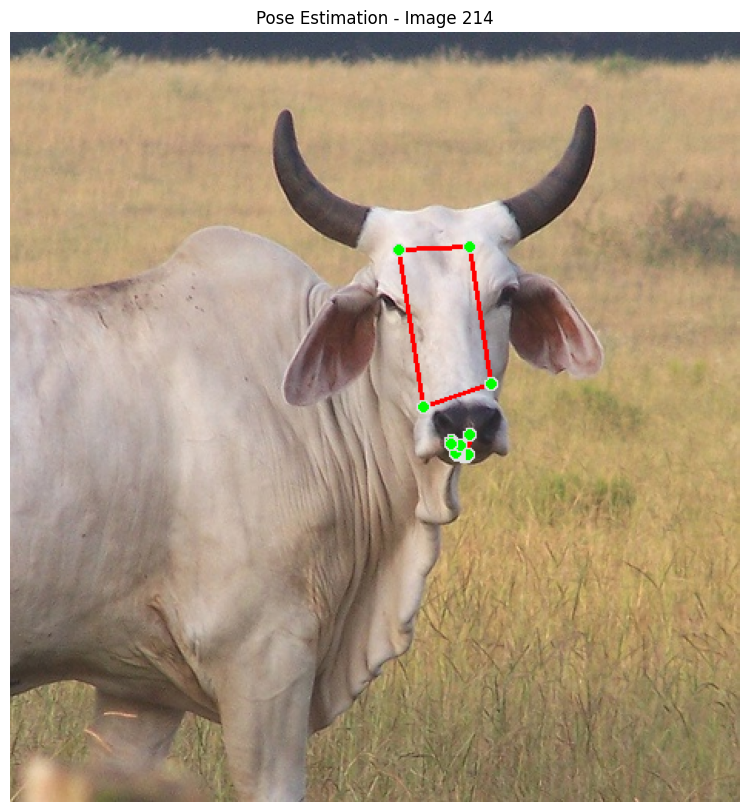

Landmarks for Image 214:
Landmark 0: x=0.61, y=0.55, z=-0.08, visibility=1.00
Landmark 1: x=0.62, y=0.55, z=-0.10, visibility=1.00
Landmark 2: x=0.63, y=0.55, z=-0.10, visibility=1.00
Landmark 3: x=0.63, y=0.55, z=-0.10, visibility=1.00
Landmark 4: x=0.61, y=0.55, z=-0.11, visibility=1.00
Landmark 5: x=0.61, y=0.55, z=-0.11, visibility=1.00
Landmark 6: x=0.61, y=0.55, z=-0.11, visibility=1.00
Landmark 7: x=0.63, y=0.52, z=-0.13, visibility=1.00
Landmark 8: x=0.60, y=0.53, z=-0.20, visibility=1.00
Landmark 9: x=0.62, y=0.54, z=-0.08, visibility=1.00
Landmark 10: x=0.60, y=0.54, z=-0.10, visibility=1.00
Landmark 11: x=0.66, y=0.46, z=-0.09, visibility=1.00
Landmark 12: x=0.57, y=0.49, z=-0.21, visibility=1.00
Landmark 13: x=0.67, y=0.44, z=-0.09, visibility=0.02
Landmark 14: x=0.55, y=0.59, z=-0.18, visibility=0.36
Landmark 15: x=0.65, y=0.42, z=-0.16, visibility=0.01
Landmark 16: x=0.57, y=0.62, z=-0.04, visibility=0.11
Landmark 17: x=0.65, y=0.42, z=-0.18, visibility=0.01
Landmark 18: 

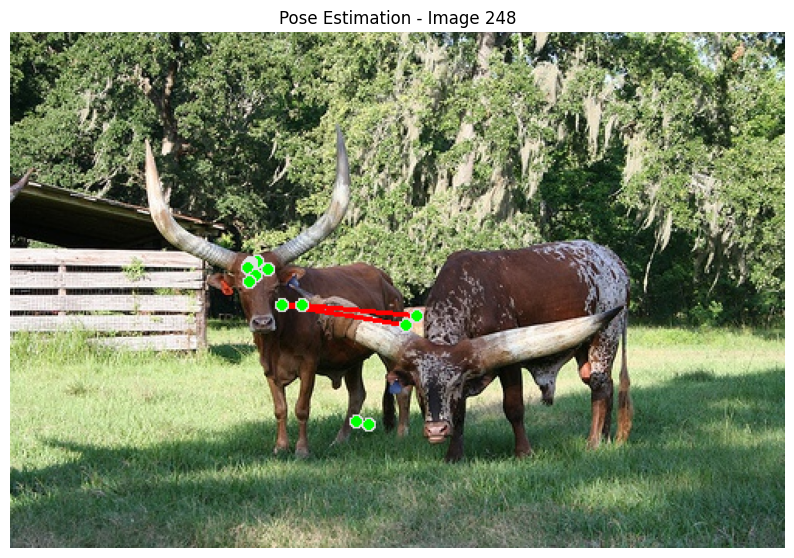

Landmarks for Image 248:
Landmark 0: x=0.32, y=0.44, z=-0.07, visibility=0.99
Landmark 1: x=0.31, y=0.45, z=-0.07, visibility=0.98
Landmark 2: x=0.31, y=0.45, z=-0.07, visibility=0.98
Landmark 3: x=0.31, y=0.45, z=-0.07, visibility=0.99
Landmark 4: x=0.31, y=0.45, z=-0.09, visibility=0.98
Landmark 5: x=0.31, y=0.45, z=-0.09, visibility=0.98
Landmark 6: x=0.31, y=0.46, z=-0.09, visibility=0.99
Landmark 7: x=0.32, y=0.47, z=-0.03, visibility=0.99
Landmark 8: x=0.31, y=0.48, z=-0.14, visibility=0.98
Landmark 9: x=0.33, y=0.46, z=-0.05, visibility=0.99
Landmark 10: x=0.33, y=0.46, z=-0.09, visibility=0.99
Landmark 11: x=0.38, y=0.53, z=-0.02, visibility=1.00
Landmark 12: x=0.35, y=0.53, z=-0.12, visibility=1.00
Landmark 13: x=0.44, y=0.63, z=-0.01, visibility=0.14
Landmark 14: x=0.37, y=0.60, z=-0.17, visibility=0.22
Landmark 15: x=0.45, y=0.75, z=-0.05, visibility=0.49
Landmark 16: x=0.36, y=0.66, z=-0.18, visibility=0.28
Landmark 17: x=0.46, y=0.76, z=-0.07, visibility=0.56
Landmark 18: 

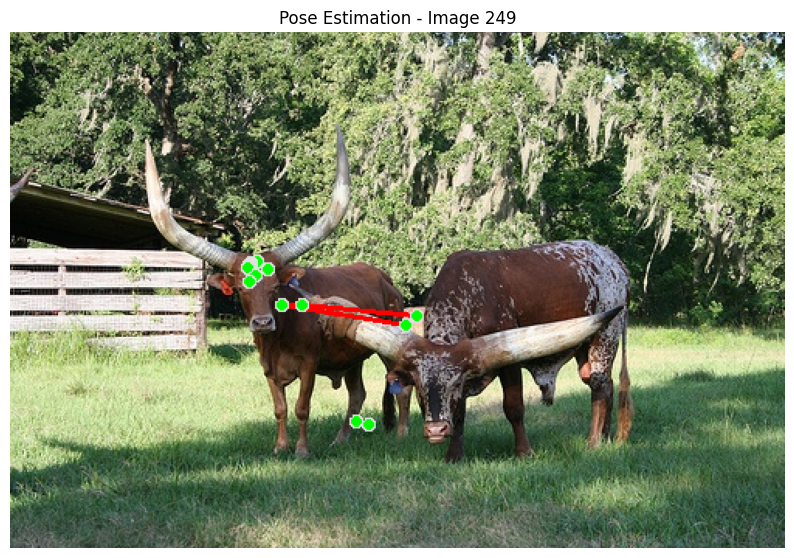

Landmarks for Image 249:
Landmark 0: x=0.32, y=0.44, z=-0.07, visibility=0.99
Landmark 1: x=0.31, y=0.45, z=-0.07, visibility=0.98
Landmark 2: x=0.31, y=0.45, z=-0.07, visibility=0.98
Landmark 3: x=0.31, y=0.45, z=-0.07, visibility=0.99
Landmark 4: x=0.31, y=0.45, z=-0.09, visibility=0.98
Landmark 5: x=0.31, y=0.45, z=-0.09, visibility=0.98
Landmark 6: x=0.31, y=0.46, z=-0.09, visibility=0.99
Landmark 7: x=0.32, y=0.47, z=-0.03, visibility=0.99
Landmark 8: x=0.31, y=0.48, z=-0.14, visibility=0.98
Landmark 9: x=0.33, y=0.46, z=-0.05, visibility=0.99
Landmark 10: x=0.33, y=0.46, z=-0.09, visibility=0.99
Landmark 11: x=0.38, y=0.53, z=-0.02, visibility=1.00
Landmark 12: x=0.35, y=0.53, z=-0.12, visibility=1.00
Landmark 13: x=0.44, y=0.63, z=-0.01, visibility=0.14
Landmark 14: x=0.37, y=0.60, z=-0.17, visibility=0.22
Landmark 15: x=0.45, y=0.75, z=-0.05, visibility=0.49
Landmark 16: x=0.36, y=0.66, z=-0.18, visibility=0.28
Landmark 17: x=0.46, y=0.76, z=-0.07, visibility=0.56
Landmark 18: 

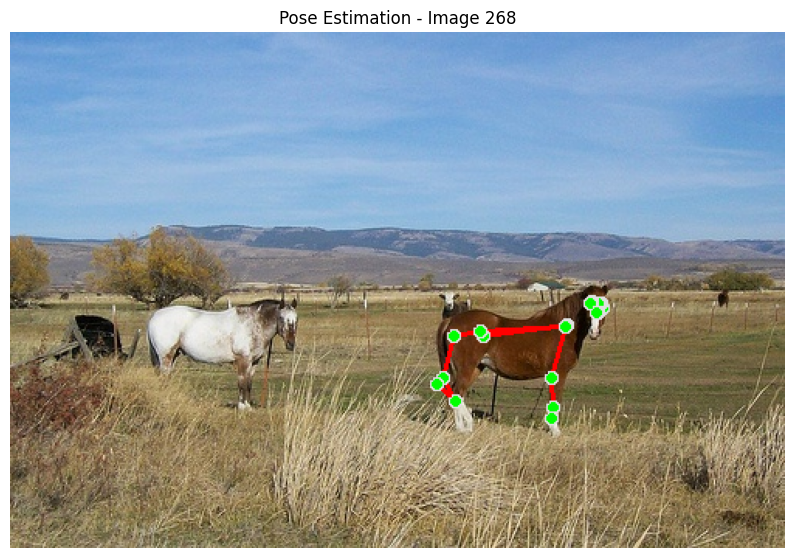

Landmarks for Image 268:
Landmark 0: x=0.77, y=0.54, z=0.08, visibility=1.00
Landmark 1: x=0.76, y=0.53, z=0.09, visibility=1.00
Landmark 2: x=0.76, y=0.53, z=0.09, visibility=1.00
Landmark 3: x=0.76, y=0.53, z=0.09, visibility=1.00
Landmark 4: x=0.76, y=0.53, z=0.07, visibility=1.00
Landmark 5: x=0.76, y=0.53, z=0.07, visibility=1.00
Landmark 6: x=0.76, y=0.53, z=0.07, visibility=1.00
Landmark 7: x=0.75, y=0.52, z=0.14, visibility=1.00
Landmark 8: x=0.75, y=0.53, z=0.02, visibility=1.00
Landmark 9: x=0.76, y=0.55, z=0.10, visibility=1.00
Landmark 10: x=0.76, y=0.55, z=0.07, visibility=1.00
Landmark 11: x=0.72, y=0.57, z=0.19, visibility=1.00
Landmark 12: x=0.72, y=0.57, z=-0.07, visibility=1.00
Landmark 13: x=0.68, y=0.60, z=0.21, visibility=0.00
Landmark 14: x=0.70, y=0.67, z=-0.07, visibility=0.53
Landmark 15: x=0.68, y=0.62, z=0.23, visibility=0.00
Landmark 16: x=0.70, y=0.73, z=0.03, visibility=0.56
Landmark 17: x=0.69, y=0.63, z=0.25, visibility=0.00
Landmark 18: x=0.70, y=0.75, 

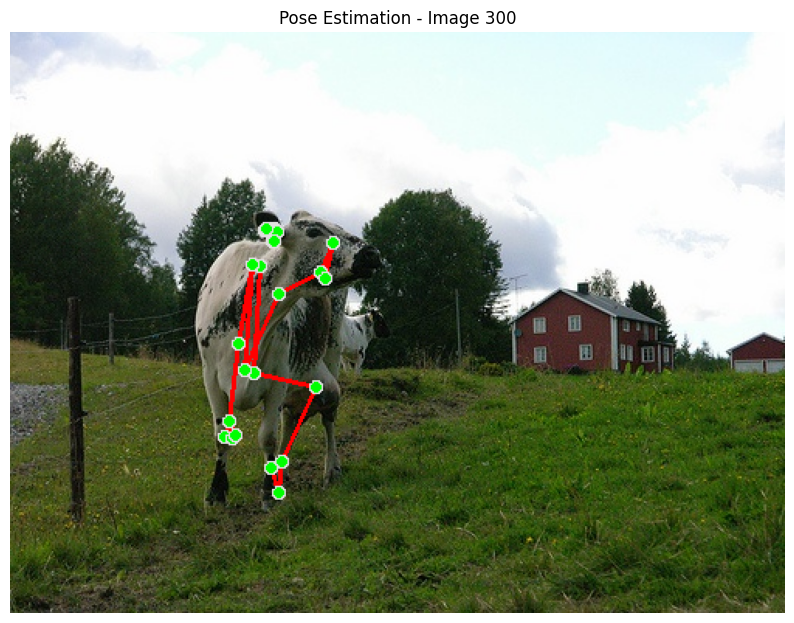

Landmarks for Image 300:
Landmark 0: x=0.34, y=0.35, z=-0.06, visibility=1.00
Landmark 1: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 2: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 3: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 4: x=0.34, y=0.34, z=-0.08, visibility=1.00
Landmark 5: x=0.34, y=0.35, z=-0.08, visibility=1.00
Landmark 6: x=0.34, y=0.35, z=-0.08, visibility=1.00
Landmark 7: x=0.33, y=0.34, z=0.01, visibility=1.00
Landmark 8: x=0.33, y=0.34, z=-0.13, visibility=1.00
Landmark 9: x=0.34, y=0.36, z=-0.04, visibility=1.00
Landmark 10: x=0.34, y=0.36, z=-0.08, visibility=1.00
Landmark 11: x=0.32, y=0.40, z=0.11, visibility=1.00
Landmark 12: x=0.31, y=0.40, z=-0.20, visibility=1.00
Landmark 13: x=0.35, y=0.49, z=0.13, visibility=0.02
Landmark 14: x=0.29, y=0.54, z=-0.27, visibility=0.90
Landmark 15: x=0.40, y=0.52, z=0.06, visibility=0.11
Landmark 16: x=0.28, y=0.67, z=-0.28, visibility=0.97
Landmark 17: x=0.41, y=0.52, z=0.06, visibility=0.17
Landmark 18: x=0.2

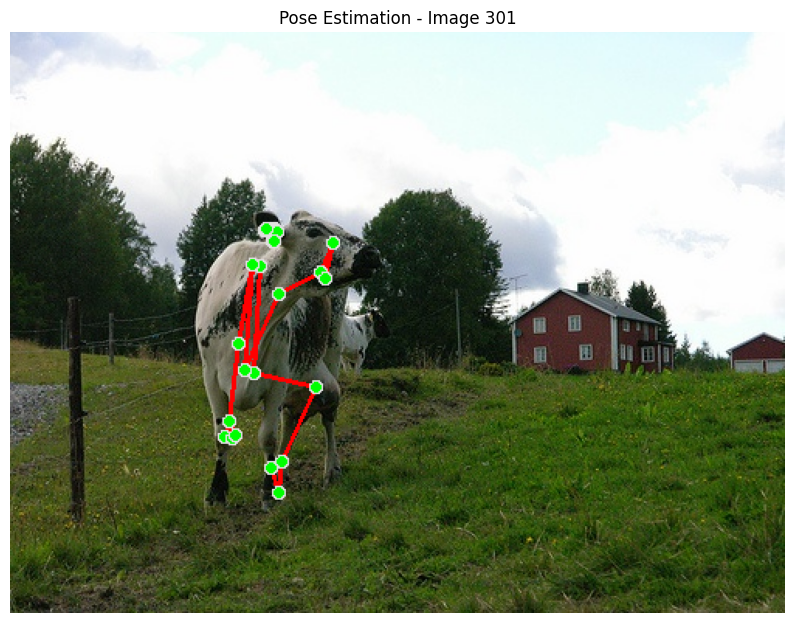

Landmarks for Image 301:
Landmark 0: x=0.34, y=0.35, z=-0.06, visibility=1.00
Landmark 1: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 2: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 3: x=0.34, y=0.34, z=-0.05, visibility=1.00
Landmark 4: x=0.34, y=0.34, z=-0.08, visibility=1.00
Landmark 5: x=0.34, y=0.35, z=-0.08, visibility=1.00
Landmark 6: x=0.34, y=0.35, z=-0.08, visibility=1.00
Landmark 7: x=0.33, y=0.34, z=0.01, visibility=1.00
Landmark 8: x=0.33, y=0.34, z=-0.13, visibility=1.00
Landmark 9: x=0.34, y=0.36, z=-0.04, visibility=1.00
Landmark 10: x=0.34, y=0.36, z=-0.08, visibility=1.00
Landmark 11: x=0.32, y=0.40, z=0.11, visibility=1.00
Landmark 12: x=0.31, y=0.40, z=-0.20, visibility=1.00
Landmark 13: x=0.35, y=0.49, z=0.13, visibility=0.02
Landmark 14: x=0.29, y=0.54, z=-0.27, visibility=0.90
Landmark 15: x=0.40, y=0.52, z=0.06, visibility=0.11
Landmark 16: x=0.28, y=0.67, z=-0.28, visibility=0.97
Landmark 17: x=0.41, y=0.52, z=0.06, visibility=0.17
Landmark 18: x=0.2

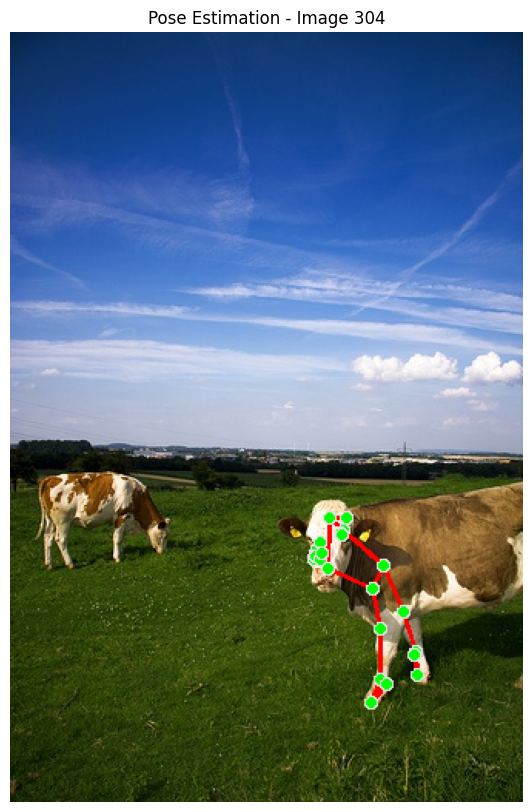

Landmarks for Image 304:
Landmark 0: x=0.60, y=0.68, z=0.37, visibility=1.00
Landmark 1: x=0.59, y=0.68, z=0.35, visibility=1.00
Landmark 2: x=0.59, y=0.68, z=0.35, visibility=1.00
Landmark 3: x=0.59, y=0.69, z=0.35, visibility=1.00
Landmark 4: x=0.60, y=0.68, z=0.36, visibility=1.00
Landmark 5: x=0.60, y=0.67, z=0.36, visibility=1.00
Landmark 6: x=0.60, y=0.67, z=0.36, visibility=1.00
Landmark 7: x=0.60, y=0.68, z=0.27, visibility=1.00
Landmark 8: x=0.60, y=0.66, z=0.31, visibility=1.00
Landmark 9: x=0.60, y=0.68, z=0.34, visibility=1.00
Landmark 10: x=0.61, y=0.68, z=0.35, visibility=1.00
Landmark 11: x=0.62, y=0.70, z=0.17, visibility=1.00
Landmark 12: x=0.62, y=0.63, z=0.18, visibility=1.00
Landmark 13: x=0.66, y=0.73, z=0.04, visibility=0.12
Landmark 14: x=0.66, y=0.63, z=0.00, visibility=0.89
Landmark 15: x=0.70, y=0.71, z=-0.03, visibility=0.25
Landmark 16: x=0.65, y=0.65, z=-0.13, visibility=0.80
Landmark 17: x=0.71, y=0.71, z=-0.05, visibility=0.38
Landmark 18: x=0.65, y=0.65,

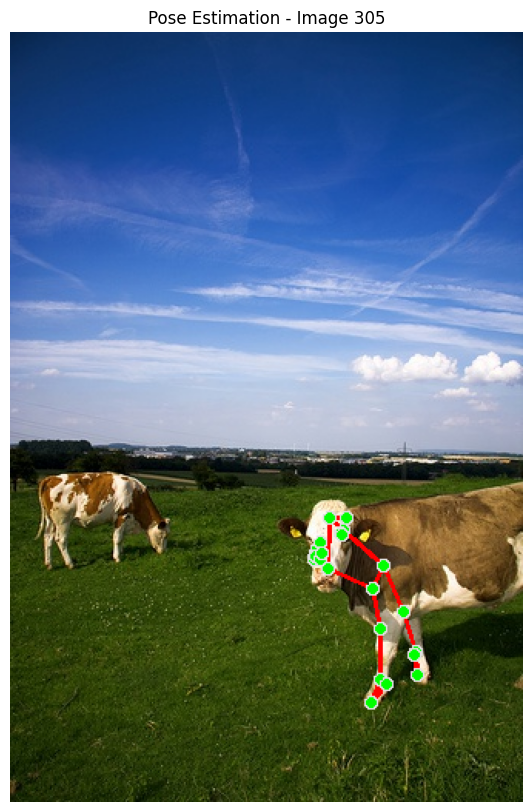

Landmarks for Image 305:
Landmark 0: x=0.60, y=0.68, z=0.37, visibility=1.00
Landmark 1: x=0.59, y=0.68, z=0.35, visibility=1.00
Landmark 2: x=0.59, y=0.68, z=0.35, visibility=1.00
Landmark 3: x=0.59, y=0.69, z=0.35, visibility=1.00
Landmark 4: x=0.60, y=0.68, z=0.36, visibility=1.00
Landmark 5: x=0.60, y=0.67, z=0.36, visibility=1.00
Landmark 6: x=0.60, y=0.67, z=0.36, visibility=1.00
Landmark 7: x=0.60, y=0.68, z=0.27, visibility=1.00
Landmark 8: x=0.60, y=0.66, z=0.31, visibility=1.00
Landmark 9: x=0.60, y=0.68, z=0.34, visibility=1.00
Landmark 10: x=0.61, y=0.68, z=0.35, visibility=1.00
Landmark 11: x=0.62, y=0.70, z=0.17, visibility=1.00
Landmark 12: x=0.62, y=0.63, z=0.18, visibility=1.00
Landmark 13: x=0.66, y=0.73, z=0.04, visibility=0.12
Landmark 14: x=0.66, y=0.63, z=0.00, visibility=0.89
Landmark 15: x=0.70, y=0.71, z=-0.03, visibility=0.25
Landmark 16: x=0.65, y=0.65, z=-0.13, visibility=0.80
Landmark 17: x=0.71, y=0.71, z=-0.05, visibility=0.38
Landmark 18: x=0.65, y=0.65,

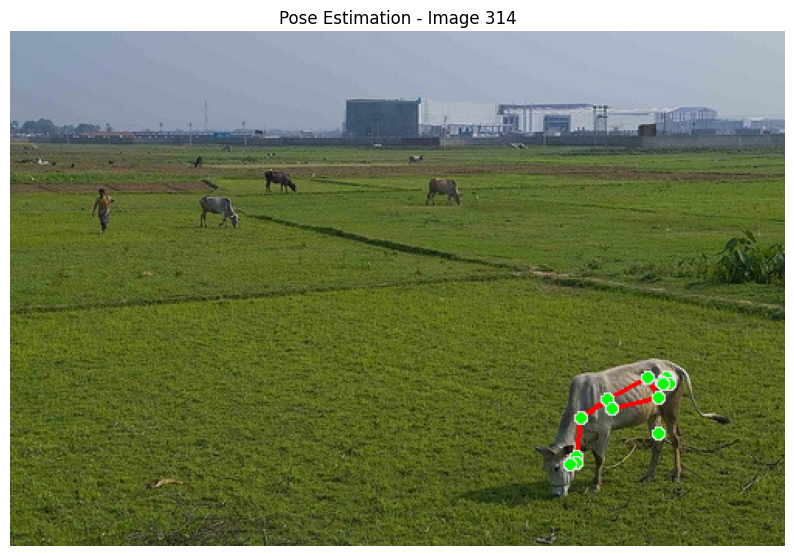

Landmarks for Image 314:
Landmark 0: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 1: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 2: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 3: x=0.85, y=0.67, z=-0.06, visibility=1.00
Landmark 4: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 5: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 6: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 7: x=0.85, y=0.67, z=-0.07, visibility=1.00
Landmark 8: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 9: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 10: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 11: x=0.82, y=0.67, z=-0.07, visibility=1.00
Landmark 12: x=0.84, y=0.71, z=-0.06, visibility=1.00
Landmark 13: x=0.82, y=0.71, z=-0.12, visibility=0.26
Landmark 14: x=0.84, y=0.76, z=-0.10, visibility=0.47
Landmark 15: x=0.83, y=0.76, z=-0.16, visibility=0.03
Landmark 16: x=0.84, y=0.78, z=-0.14, visibility=0.57
Landmark 17: x=0.83, y=0.77, z=-0.17, visibility=0.03
Landmark 18: 

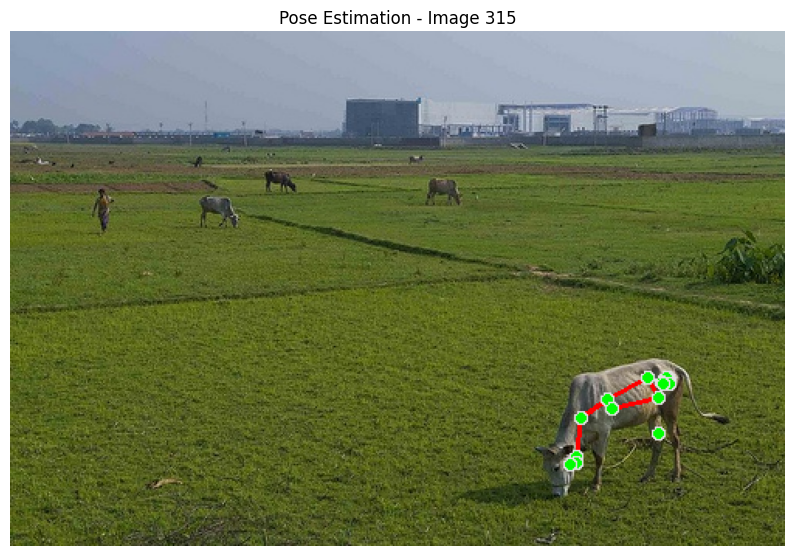

Landmarks for Image 315:
Landmark 0: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 1: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 2: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 3: x=0.85, y=0.67, z=-0.06, visibility=1.00
Landmark 4: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 5: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 6: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 7: x=0.85, y=0.67, z=-0.07, visibility=1.00
Landmark 8: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 9: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 10: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 11: x=0.82, y=0.67, z=-0.07, visibility=1.00
Landmark 12: x=0.84, y=0.71, z=-0.06, visibility=1.00
Landmark 13: x=0.82, y=0.71, z=-0.12, visibility=0.26
Landmark 14: x=0.84, y=0.76, z=-0.10, visibility=0.47
Landmark 15: x=0.83, y=0.76, z=-0.16, visibility=0.03
Landmark 16: x=0.84, y=0.78, z=-0.14, visibility=0.57
Landmark 17: x=0.83, y=0.77, z=-0.17, visibility=0.03
Landmark 18: 

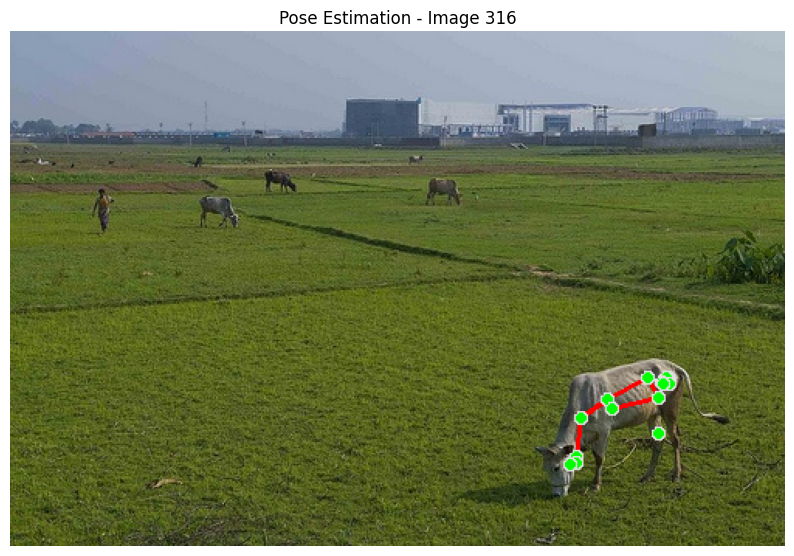

Landmarks for Image 316:
Landmark 0: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 1: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 2: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 3: x=0.85, y=0.67, z=-0.06, visibility=1.00
Landmark 4: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 5: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 6: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 7: x=0.85, y=0.67, z=-0.07, visibility=1.00
Landmark 8: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 9: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 10: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 11: x=0.82, y=0.67, z=-0.07, visibility=1.00
Landmark 12: x=0.84, y=0.71, z=-0.06, visibility=1.00
Landmark 13: x=0.82, y=0.71, z=-0.12, visibility=0.26
Landmark 14: x=0.84, y=0.76, z=-0.10, visibility=0.47
Landmark 15: x=0.83, y=0.76, z=-0.16, visibility=0.03
Landmark 16: x=0.84, y=0.78, z=-0.14, visibility=0.57
Landmark 17: x=0.83, y=0.77, z=-0.17, visibility=0.03
Landmark 18: 

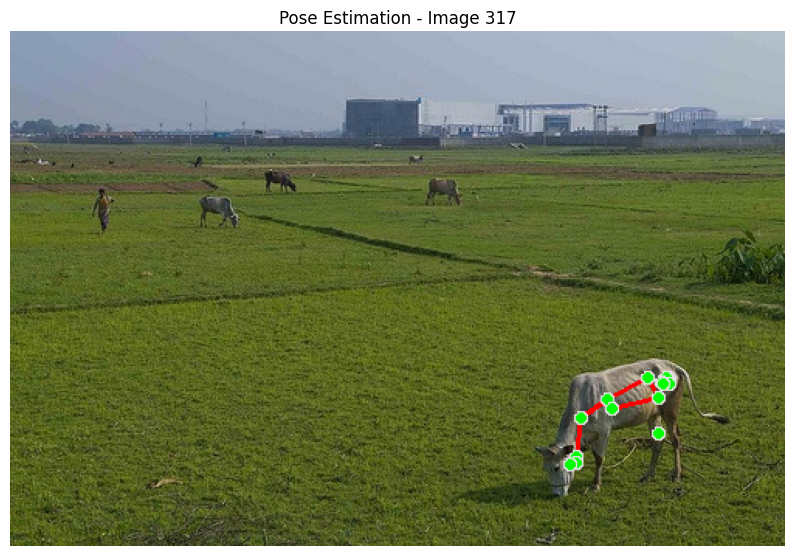

Landmarks for Image 317:
Landmark 0: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 1: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 2: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 3: x=0.85, y=0.67, z=-0.06, visibility=1.00
Landmark 4: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 5: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 6: x=0.85, y=0.68, z=-0.05, visibility=1.00
Landmark 7: x=0.85, y=0.67, z=-0.07, visibility=1.00
Landmark 8: x=0.85, y=0.68, z=-0.06, visibility=1.00
Landmark 9: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 10: x=0.84, y=0.68, z=-0.05, visibility=1.00
Landmark 11: x=0.82, y=0.67, z=-0.07, visibility=1.00
Landmark 12: x=0.84, y=0.71, z=-0.06, visibility=1.00
Landmark 13: x=0.82, y=0.71, z=-0.12, visibility=0.26
Landmark 14: x=0.84, y=0.76, z=-0.10, visibility=0.47
Landmark 15: x=0.83, y=0.76, z=-0.16, visibility=0.03
Landmark 16: x=0.84, y=0.78, z=-0.14, visibility=0.57
Landmark 17: x=0.83, y=0.77, z=-0.17, visibility=0.03
Landmark 18: 

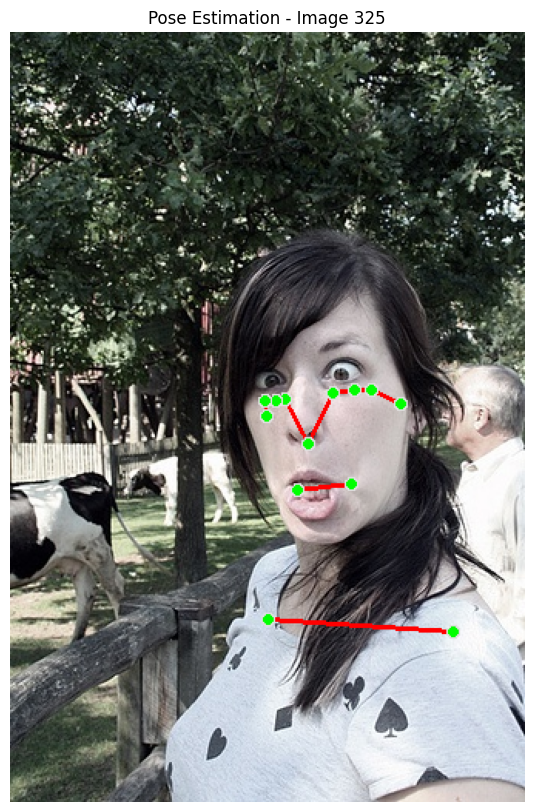

Landmarks for Image 325:
Landmark 0: x=0.58, y=0.53, z=-1.88, visibility=1.00
Landmark 1: x=0.63, y=0.47, z=-1.82, visibility=1.00
Landmark 2: x=0.67, y=0.47, z=-1.82, visibility=1.00
Landmark 3: x=0.70, y=0.47, z=-1.82, visibility=1.00
Landmark 4: x=0.53, y=0.48, z=-1.69, visibility=1.00
Landmark 5: x=0.52, y=0.48, z=-1.70, visibility=1.00
Landmark 6: x=0.50, y=0.48, z=-1.70, visibility=1.00
Landmark 7: x=0.76, y=0.48, z=-1.26, visibility=1.00
Landmark 8: x=0.50, y=0.50, z=-0.68, visibility=1.00
Landmark 9: x=0.66, y=0.59, z=-1.64, visibility=1.00
Landmark 10: x=0.56, y=0.60, z=-1.49, visibility=1.00
Landmark 11: x=0.86, y=0.78, z=-1.28, visibility=1.00
Landmark 12: x=0.50, y=0.76, z=0.34, visibility=0.99
Landmark 13: x=0.95, y=1.17, z=-1.89, visibility=0.64
Landmark 14: x=0.42, y=1.12, z=0.68, visibility=0.01
Landmark 15: x=0.92, y=1.49, z=-2.56, visibility=0.11
Landmark 16: x=0.25, y=1.34, z=0.18, visibility=0.01
Landmark 17: x=0.97, y=1.58, z=-2.83, visibility=0.11
Landmark 18: x=0

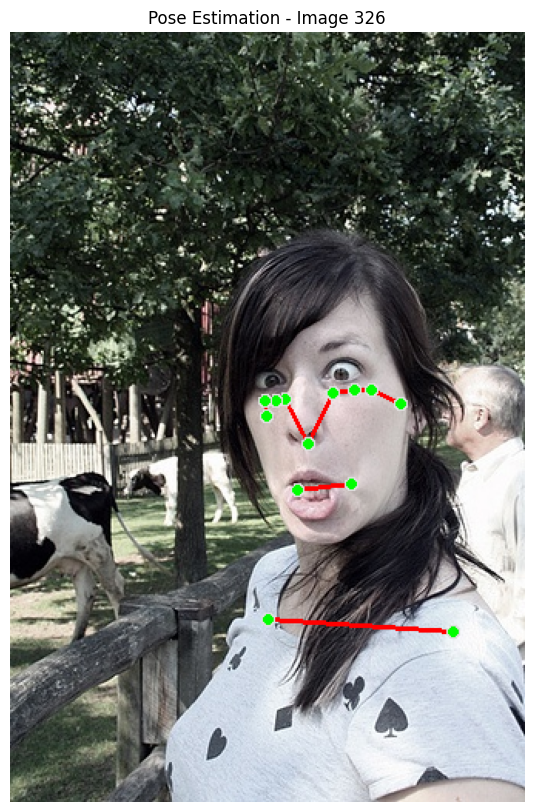

Landmarks for Image 326:
Landmark 0: x=0.58, y=0.53, z=-1.88, visibility=1.00
Landmark 1: x=0.63, y=0.47, z=-1.82, visibility=1.00
Landmark 2: x=0.67, y=0.47, z=-1.82, visibility=1.00
Landmark 3: x=0.70, y=0.47, z=-1.82, visibility=1.00
Landmark 4: x=0.53, y=0.48, z=-1.69, visibility=1.00
Landmark 5: x=0.52, y=0.48, z=-1.70, visibility=1.00
Landmark 6: x=0.50, y=0.48, z=-1.70, visibility=1.00
Landmark 7: x=0.76, y=0.48, z=-1.26, visibility=1.00
Landmark 8: x=0.50, y=0.50, z=-0.68, visibility=1.00
Landmark 9: x=0.66, y=0.59, z=-1.64, visibility=1.00
Landmark 10: x=0.56, y=0.60, z=-1.49, visibility=1.00
Landmark 11: x=0.86, y=0.78, z=-1.28, visibility=1.00
Landmark 12: x=0.50, y=0.76, z=0.34, visibility=0.99
Landmark 13: x=0.95, y=1.17, z=-1.89, visibility=0.64
Landmark 14: x=0.42, y=1.12, z=0.68, visibility=0.01
Landmark 15: x=0.92, y=1.49, z=-2.56, visibility=0.11
Landmark 16: x=0.25, y=1.34, z=0.18, visibility=0.01
Landmark 17: x=0.97, y=1.58, z=-2.83, visibility=0.11
Landmark 18: x=0

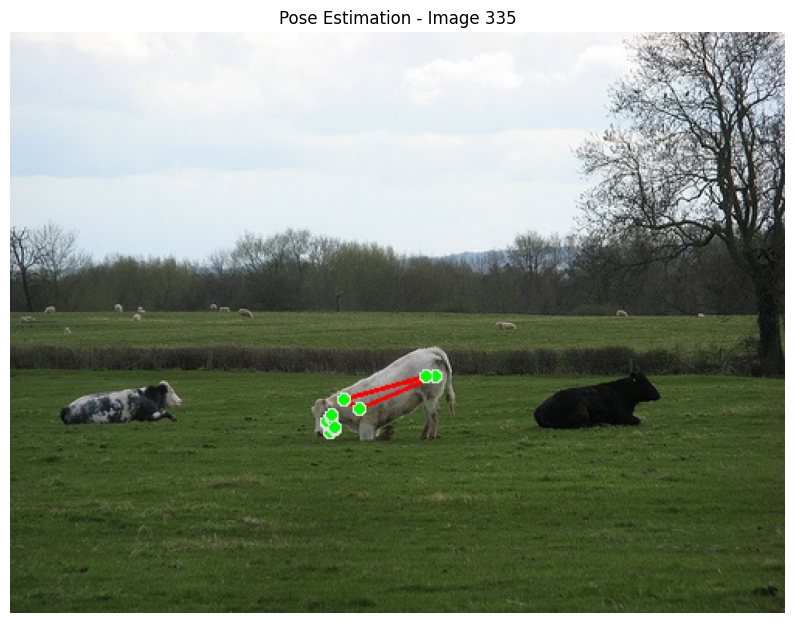

Landmarks for Image 335:
Landmark 0: x=0.41, y=0.69, z=-0.17, visibility=1.00
Landmark 1: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 2: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 3: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 4: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 5: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 6: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 7: x=0.42, y=0.67, z=-0.25, visibility=1.00
Landmark 8: x=0.41, y=0.66, z=-0.11, visibility=0.99
Landmark 9: x=0.42, y=0.69, z=-0.19, visibility=1.00
Landmark 10: x=0.42, y=0.68, z=-0.15, visibility=1.00
Landmark 11: x=0.45, y=0.65, z=-0.29, visibility=1.00
Landmark 12: x=0.43, y=0.63, z=-0.02, visibility=1.00
Landmark 13: x=0.52, y=0.65, z=-0.28, visibility=0.09
Landmark 14: x=0.48, y=0.62, z=0.01, visibility=0.00
Landmark 15: x=0.55, y=0.67, z=-0.23, visibility=0.04
Landmark 16: x=0.48, y=0.67, z=-0.05, visibility=0.06
Landmark 17: x=0.55, y=0.69, z=-0.24, visibility=0.04
Landmark 18: x

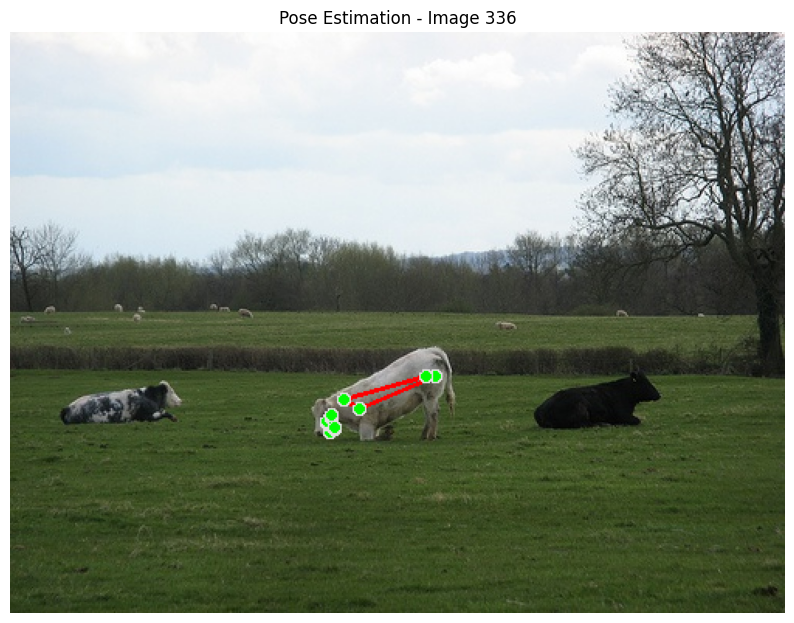

Landmarks for Image 336:
Landmark 0: x=0.41, y=0.69, z=-0.17, visibility=1.00
Landmark 1: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 2: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 3: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 4: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 5: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 6: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 7: x=0.42, y=0.67, z=-0.25, visibility=1.00
Landmark 8: x=0.41, y=0.66, z=-0.11, visibility=0.99
Landmark 9: x=0.42, y=0.69, z=-0.19, visibility=1.00
Landmark 10: x=0.42, y=0.68, z=-0.15, visibility=1.00
Landmark 11: x=0.45, y=0.65, z=-0.29, visibility=1.00
Landmark 12: x=0.43, y=0.63, z=-0.02, visibility=1.00
Landmark 13: x=0.52, y=0.65, z=-0.28, visibility=0.09
Landmark 14: x=0.48, y=0.62, z=0.01, visibility=0.00
Landmark 15: x=0.55, y=0.67, z=-0.23, visibility=0.04
Landmark 16: x=0.48, y=0.67, z=-0.05, visibility=0.06
Landmark 17: x=0.55, y=0.69, z=-0.24, visibility=0.04
Landmark 18: x

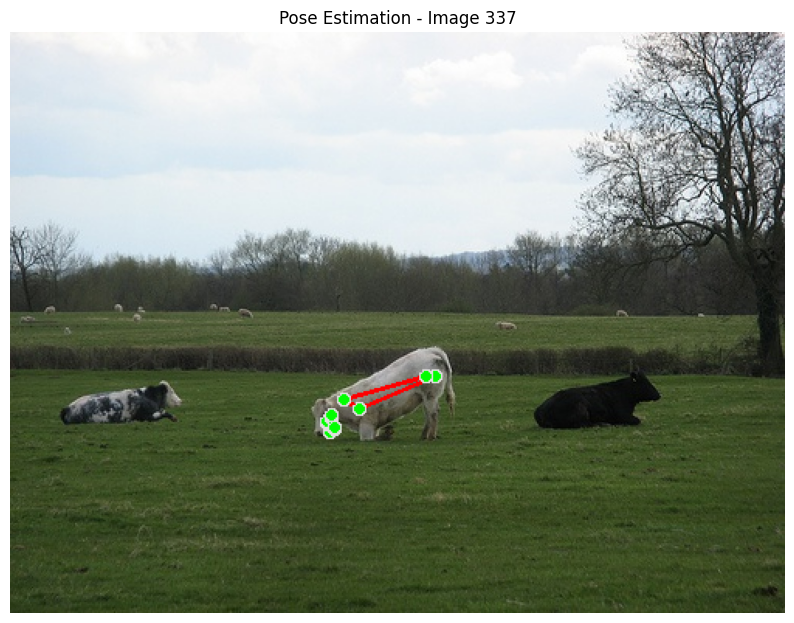

Landmarks for Image 337:
Landmark 0: x=0.41, y=0.69, z=-0.17, visibility=1.00
Landmark 1: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 2: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 3: x=0.41, y=0.68, z=-0.19, visibility=1.00
Landmark 4: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 5: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 6: x=0.41, y=0.67, z=-0.16, visibility=1.00
Landmark 7: x=0.42, y=0.67, z=-0.25, visibility=1.00
Landmark 8: x=0.41, y=0.66, z=-0.11, visibility=0.99
Landmark 9: x=0.42, y=0.69, z=-0.19, visibility=1.00
Landmark 10: x=0.42, y=0.68, z=-0.15, visibility=1.00
Landmark 11: x=0.45, y=0.65, z=-0.29, visibility=1.00
Landmark 12: x=0.43, y=0.63, z=-0.02, visibility=1.00
Landmark 13: x=0.52, y=0.65, z=-0.28, visibility=0.09
Landmark 14: x=0.48, y=0.62, z=0.01, visibility=0.00
Landmark 15: x=0.55, y=0.67, z=-0.23, visibility=0.04
Landmark 16: x=0.48, y=0.67, z=-0.05, visibility=0.06
Landmark 17: x=0.55, y=0.69, z=-0.24, visibility=0.04
Landmark 18: x

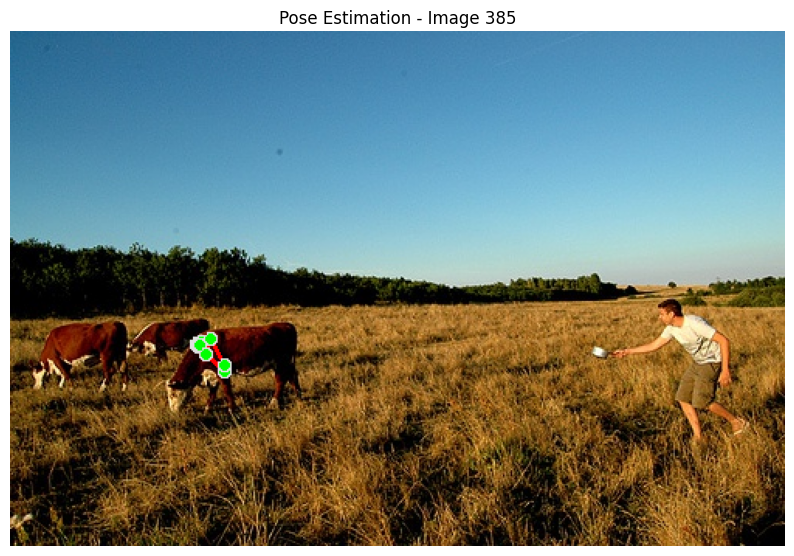

Landmarks for Image 385:
Landmark 0: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 1: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 2: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 3: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 4: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 5: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 6: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 7: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 8: x=0.25, y=0.60, z=-0.22, visibility=1.00
Landmark 9: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 10: x=0.24, y=0.61, z=-0.23, visibility=1.00
Landmark 11: x=0.25, y=0.63, z=-0.18, visibility=0.99
Landmark 12: x=0.26, y=0.60, z=-0.17, visibility=0.99
Landmark 13: x=0.23, y=0.66, z=-0.17, visibility=0.17
Landmark 14: x=0.25, y=0.59, z=-0.13, visibility=0.03
Landmark 15: x=0.21, y=0.67, z=-0.19, visibility=0.15
Landmark 16: x=0.24, y=0.58, z=-0.12, visibility=0.01
Landmark 17: x=0.21, y=0.68, z=-0.20, visibility=0.16
Landmark 18: 

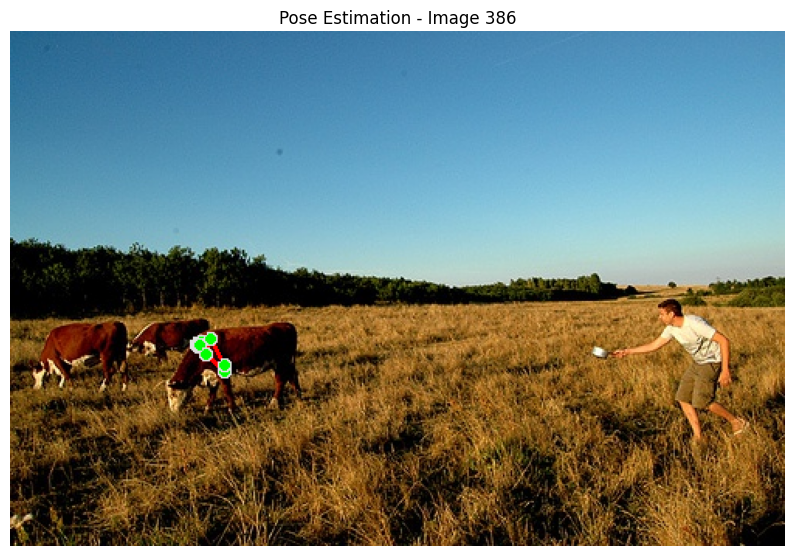

Landmarks for Image 386:
Landmark 0: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 1: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 2: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 3: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 4: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 5: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 6: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 7: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 8: x=0.25, y=0.60, z=-0.22, visibility=1.00
Landmark 9: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 10: x=0.24, y=0.61, z=-0.23, visibility=1.00
Landmark 11: x=0.25, y=0.63, z=-0.18, visibility=0.99
Landmark 12: x=0.26, y=0.60, z=-0.17, visibility=0.99
Landmark 13: x=0.23, y=0.66, z=-0.17, visibility=0.17
Landmark 14: x=0.25, y=0.59, z=-0.13, visibility=0.03
Landmark 15: x=0.21, y=0.67, z=-0.19, visibility=0.15
Landmark 16: x=0.24, y=0.58, z=-0.12, visibility=0.01
Landmark 17: x=0.21, y=0.68, z=-0.20, visibility=0.16
Landmark 18: 

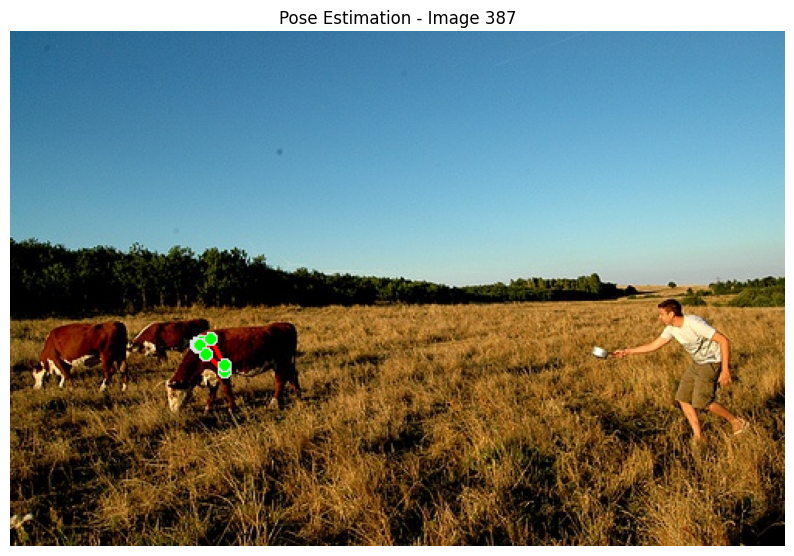

Landmarks for Image 387:
Landmark 0: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 1: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 2: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 3: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 4: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 5: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 6: x=0.24, y=0.61, z=-0.25, visibility=1.00
Landmark 7: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 8: x=0.25, y=0.60, z=-0.22, visibility=1.00
Landmark 9: x=0.24, y=0.61, z=-0.24, visibility=1.00
Landmark 10: x=0.24, y=0.61, z=-0.23, visibility=1.00
Landmark 11: x=0.25, y=0.63, z=-0.18, visibility=0.99
Landmark 12: x=0.26, y=0.60, z=-0.17, visibility=0.99
Landmark 13: x=0.23, y=0.66, z=-0.17, visibility=0.17
Landmark 14: x=0.25, y=0.59, z=-0.13, visibility=0.03
Landmark 15: x=0.21, y=0.67, z=-0.19, visibility=0.15
Landmark 16: x=0.24, y=0.58, z=-0.12, visibility=0.01
Landmark 17: x=0.21, y=0.68, z=-0.20, visibility=0.16
Landmark 18: 

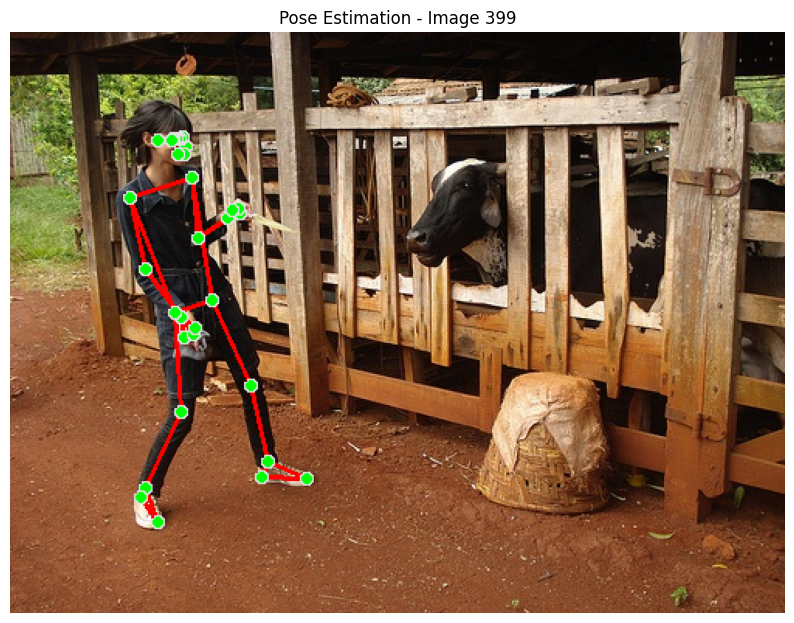

Landmarks for Image 399:
Landmark 0: x=0.23, y=0.20, z=-0.18, visibility=1.00
Landmark 1: x=0.22, y=0.18, z=-0.17, visibility=1.00
Landmark 2: x=0.22, y=0.18, z=-0.17, visibility=1.00
Landmark 3: x=0.22, y=0.18, z=-0.17, visibility=1.00
Landmark 4: x=0.22, y=0.19, z=-0.20, visibility=1.00
Landmark 5: x=0.21, y=0.18, z=-0.20, visibility=1.00
Landmark 6: x=0.21, y=0.18, z=-0.20, visibility=1.00
Landmark 7: x=0.21, y=0.19, z=-0.06, visibility=1.00
Landmark 8: x=0.19, y=0.19, z=-0.20, visibility=1.00
Landmark 9: x=0.22, y=0.21, z=-0.14, visibility=1.00
Landmark 10: x=0.22, y=0.21, z=-0.18, visibility=1.00
Landmark 11: x=0.23, y=0.25, z=0.06, visibility=1.00
Landmark 12: x=0.15, y=0.29, z=-0.21, visibility=1.00
Landmark 13: x=0.24, y=0.35, z=0.08, visibility=0.66
Landmark 14: x=0.17, y=0.41, z=-0.22, visibility=1.00
Landmark 15: x=0.28, y=0.32, z=-0.06, visibility=0.97
Landmark 16: x=0.22, y=0.49, z=-0.23, visibility=1.00
Landmark 17: x=0.30, y=0.31, z=-0.08, visibility=0.97
Landmark 18: x=

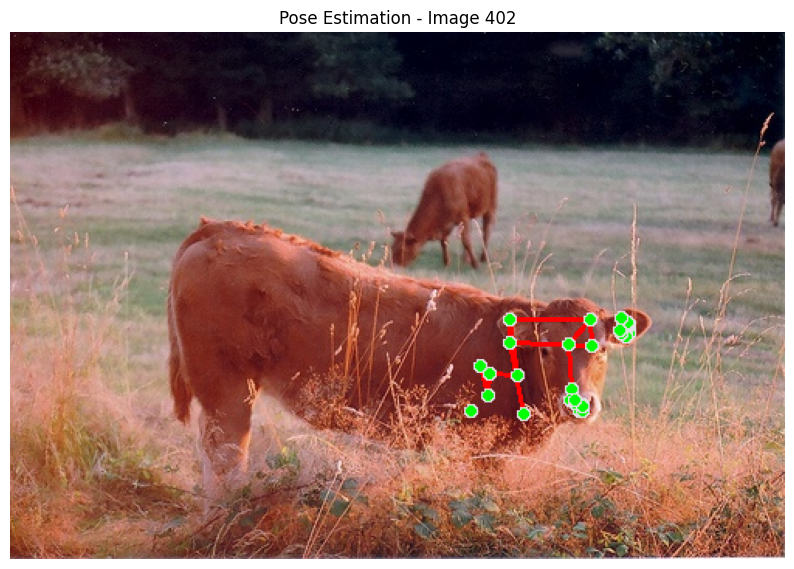

Landmarks for Image 402:
Landmark 0: x=0.80, y=0.57, z=0.05, visibility=1.00
Landmark 1: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 2: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 3: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 4: x=0.80, y=0.56, z=0.06, visibility=1.00
Landmark 5: x=0.80, y=0.55, z=0.06, visibility=1.00
Landmark 6: x=0.80, y=0.55, z=0.06, visibility=1.00
Landmark 7: x=0.79, y=0.58, z=0.18, visibility=1.00
Landmark 8: x=0.79, y=0.54, z=0.09, visibility=1.00
Landmark 9: x=0.79, y=0.57, z=0.09, visibility=1.00
Landmark 10: x=0.79, y=0.57, z=0.06, visibility=1.00
Landmark 11: x=0.75, y=0.60, z=0.24, visibility=1.00
Landmark 12: x=0.75, y=0.55, z=0.01, visibility=1.00
Landmark 13: x=0.74, y=0.65, z=0.22, visibility=0.26
Landmark 14: x=0.72, y=0.59, z=-0.11, visibility=0.82
Landmark 15: x=0.74, y=0.71, z=0.08, visibility=0.65
Landmark 16: x=0.73, y=0.68, z=-0.19, visibility=0.84
Landmark 17: x=0.74, y=0.72, z=0.07, visibility=0.74
Landmark 18: x=0.72, y=0.70, 

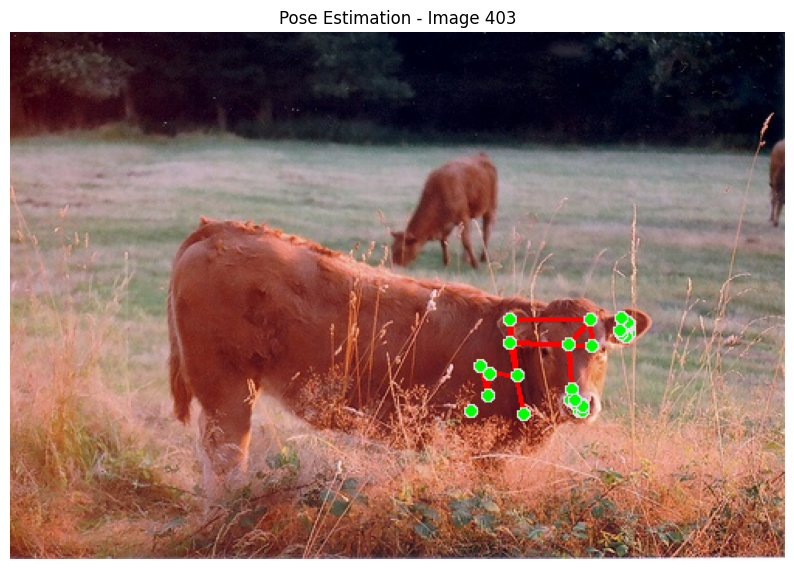

Landmarks for Image 403:
Landmark 0: x=0.80, y=0.57, z=0.05, visibility=1.00
Landmark 1: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 2: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 3: x=0.80, y=0.57, z=0.08, visibility=1.00
Landmark 4: x=0.80, y=0.56, z=0.06, visibility=1.00
Landmark 5: x=0.80, y=0.55, z=0.06, visibility=1.00
Landmark 6: x=0.80, y=0.55, z=0.06, visibility=1.00
Landmark 7: x=0.79, y=0.58, z=0.18, visibility=1.00
Landmark 8: x=0.79, y=0.54, z=0.09, visibility=1.00
Landmark 9: x=0.79, y=0.57, z=0.09, visibility=1.00
Landmark 10: x=0.79, y=0.57, z=0.06, visibility=1.00
Landmark 11: x=0.75, y=0.60, z=0.24, visibility=1.00
Landmark 12: x=0.75, y=0.55, z=0.01, visibility=1.00
Landmark 13: x=0.74, y=0.65, z=0.22, visibility=0.26
Landmark 14: x=0.72, y=0.59, z=-0.11, visibility=0.82
Landmark 15: x=0.74, y=0.71, z=0.08, visibility=0.65
Landmark 16: x=0.73, y=0.68, z=-0.19, visibility=0.84
Landmark 17: x=0.74, y=0.72, z=0.07, visibility=0.74
Landmark 18: x=0.72, y=0.70, 

In [12]:
# Instalar as dependências necessárias
!pip install mediapipe opencv-python-headless

import cv2
import mediapipe as mp
import pandas as pd
import matplotlib.pyplot as plt

# Inicializar o modelo de pose do MediaPipe
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils
pose = mp_pose.Pose(static_image_mode=True, model_complexity=2, min_detection_confidence=0.5)

# Função para processar uma imagem e extrair os pontos-chave da pose
def process_image(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    results = pose.process(image_rgb)

    if results.pose_landmarks:
        # Desenhar os pontos-chave e conexões na imagem
        annotated_image = image.copy()
        mp_drawing.draw_landmarks(
            annotated_image,
            results.pose_landmarks,
            mp_pose.POSE_CONNECTIONS,
            landmark_drawing_spec=mp_drawing.DrawingSpec(color=(0, 255, 0), thickness=2, circle_radius=2),
            connection_drawing_spec=mp_drawing.DrawingSpec(color=(0, 0, 255), thickness=2)
        )

        # Extrair coordenadas dos pontos-chave
        landmarks = []
        for landmark in results.pose_landmarks.landmark:
            landmarks.append({
                'x': landmark.x,
                'y': landmark.y,
                'z': landmark.z,
                'visibility': landmark.visibility
            })

        return annotated_image, landmarks
    else:
        return None, None

image_paths = df_filtered['image_path'].tolist()

# Processar todas as imagens
for i, image_path in enumerate(image_paths):
    annotated_image, landmarks = process_image(image_path)

    if annotated_image is not None:
        # Exibir a imagem com os pontos-chave detectados
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
        plt.title(f'Pose Estimation - Image {i+1}')
        plt.axis('off')
        plt.show()

        # Imprimir as coordenadas dos pontos-chave
        print(f'Landmarks for Image {i+1}:')
        for j, landmark in enumerate(landmarks):
            print(f'Landmark {j}: x={landmark["x"]:.2f}, y={landmark["y"]:.2f}, z={landmark["z"]:.2f}, visibility={landmark["visibility"]:.2f}')
        print('\n')
    else:
        print(f'No pose detected in Image {i+1}')

# Liberar recursos
pose.close()